<a href="https://colab.research.google.com/github/GITADDed/colab/blob/main/NeouroBaby_FEC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Импорты

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
import pandas as pd
import numpy as np
import os
import pickle
import matplotlib.pyplot as plt
import keras
import sklearn
import mlxtend
import keras.layers
import keras.layers.normalization
import collections

from PIL import Image
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications import EfficientNetB4
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras import layers, models
from keras.layers import Dense, Dropout, Input, Conv2D, MaxPool2D, Flatten, Activation
from keras.utils import to_categorical
from keras.optimizers import Adam
from keras.models import Model
from keras.layers.normalization import BatchNormalization
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


Подключение TPU

In [ ]:
try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
  print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
except ValueError:
  raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')
 
tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)

Running on TPU  ['10.5.241.98:8470']
INFO:tensorflow:Initializing the TPU system: grpc://10.5.241.98:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.5.241.98:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


Необходимые функции

In [ ]:
# Перевод данных в массив и разделение на фото лиц и соответсвующие им эмоции
def prepare_data(pixels, labels):  
    a = []
    
    for i in range(len(pixels)):
            image_string = (pixels)[i].split(' ') 
            image_data = np.asarray(image_string, dtype=np.uint8).reshape(48,48,1)
            a.append(image_data)
    labels = pd.Series(labels)
    labels = labels.values.reshape(len(labels),1)

    return np.array(a), np.array(labels)

def prepare_data1(data):
  image_array = np.zeros(shape=(len(data), 48, 48))
  image_label = np.array(list(map(int, data['emotion'])))
    
  for i, row in enumerate(data.index):
      image = np.fromstring(data.loc[row, ' pixels'], dtype=int, sep=' ')
      image = np.reshape(image, (48, 48))
      image_array[i] = image
        
  return image_array, image_label

# Отображение фото с его эмоцией и вывод выходного слоя нейронной сети
def plot_image_and_emotion(test_image_array, test_image_label, pred_test_labels, image_number):
    
    fig, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=False)
    
    bar_label = emotions.values()
    k = np.reshape(test_image_array, (test_image_array.shape[0], 48, 48))
    b = np.reshape(test_image_label, (test_image_label.shape[0], 1))
    axs[0].imshow(k[image_number], 'gray')
    axs[0].set_title(b[image_number])
    
    axs[1].bar(bar_label, pred_test_labels[image_number], color='orange', alpha=0.7)
    axs[1].grid()
    
    plt.show()

# Отображение графиков обучения
def func(history):
  loss =  history.history['loss']
  loss_val = history.history['val_loss']
  epochs = range(1, len(loss)+1)
  plt.plot(epochs, loss, 'bo', label='loss_train')
  plt.plot(epochs, loss_val, 'b', label='loss_val')
  plt.title('the loss function')
  plt.xlabel('epochs')
  plt.ylabel('value of the loss function')
  plt.legend()
  plt.grid()
  plt.show()
  
  acc = history.history['accuracy']
  acc_val = history.history['val_accuracy']
  epochs = range(1, len(loss)+1)
  plt.plot(epochs, acc, 'bo', label='accuracy_train')
  plt.plot(epochs, acc_val, 'b', label='accuracy_val')
  plt.title('accuracy')
  plt.xlabel('epochs')
  plt.ylabel('accuracy')
  plt.legend()
  plt.grid()
  plt.show()

# Начало блока функций для визуализации результатов
def activ_model_pred(num_layer):
  activation_model = Model(inputs=tpu_model.input, outputs=tpu_model.layers[num_layer].output)
  return activation_model.predict(test_images)
 
def print_layers_vision(activation, image_num):
  images_per_row = 8
  n_filters = activation.shape[-1]
  size = activation.shape[1]
  n_cols = n_filters // images_per_row
 
  display_grid = np.zeros((n_cols * size, images_per_row * size))
 
  for col in range(n_cols):
      for row in range(images_per_row):
          channel_image = activation[image_num, :, :, col * images_per_row + row]
          channel_image -= channel_image.mean()
          channel_image /= channel_image.std()
          channel_image *= 64
          channel_image += 128
          channel_image = np.clip(channel_image, 0, 255).astype('uint8')
          display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
 
  scale = 1. / size
  plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
  plt.grid(False)
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
 
def print_facials(from_id, to_id, num_layer):
  for image_num in range(from_id, to_id):
    plot_image_and_emotion(test_image_array, test_image_label, pred_test_labels, image_num)
    print_layers_vision(activ_model_pred(num_layer), image_num)
# Конце блока визуализации

Подключение данных

In [ ]:
# dataset_path = "/content/drive/MyDrive/NeuroBaby_FEC/data_set/icml_face_data.csv"
# data = pd.read_csv(dataset_path)
data = pd.read_csv('/content/drive/MyDrive/NeuroBaby_FEC/data_set/train.csv')

emotions = {
    0: 'Angry', 
    1: 'Disgust', 
    2: 'Fear', 
    3: 'Happy', 
    4: 'Sad', 
    5: 'Surprise', 
    6: 'Neutral'
}

Просмотр данных

In [ ]:
data.head()

,emotion,pixels
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...
1,0,151 150 147 155 148 133 111 140 170 174 182 15...
2,2,231 212 156 164 174 138 161 173 182 200 106 38...
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...


Подготовка данных для использования

In [ ]:
oversample = RandomOverSampler(sampling_strategy='auto')
# data_set = data[data[' Usage']=='Training']
image_array_ov, image_label_ov = oversample.fit_resample((data['pixels']).values.reshape(-1, 1), data['emotion'])
collections.Counter(np.array(image_label_ov))
train_image_array, test_image_array, train_image_label, test_image_label = train_test_split(image_array_ov,image_label_ov, test_size=0.2)
train_image_array, train_image_label = prepare_data(pd.Series(train_image_array.flatten()), train_image_label)
test_image_array, test_image_label = prepare_data(pd.Series(test_image_array.flatten()), test_image_label)
# train_image_array, train_image_label = prepare_data(pd.Series(train_image_array.flatten()), train_image_label)
# # data_set = data[data[' Usage']=='Training']
# # train_image_array, train_image_label = prepare_data1(data_set.loc[data_set['emotion']!=1])
# data_set = data[data[' Usage']=='PrivateTest']
# val_image_array, val_image_label = oversample.fit_resample((data_set[' pixels']).values.reshape(-1, 1), data_set['emotion'])
# val_image_array, val_image_label = prepare_data(pd.Series(val_image_array.flatten()), val_image_label)
# # val_image_array, val_image_label = prepare_data1(data_set[data_set['emotion']!=1])
# data_set = data[data[' Usage']=='PublicTest']
# test_image_array, test_image_label = prepare_data1(data_set[data_set['emotion']!=1])

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
collections.Counter(pd.Series(test_image_label.flatten()))

Counter({0: 1399, 1: 1481, 2: 1423, 3: 1416, 4: 1459, 5: 1483, 6: 1440})

Нормализация данных

In [ ]:
# train_image_array = list(train_image_array)
# val_image_array   = list(val_image_array)
# test_image_array  = list(test_image_array)

# for i,item in enumerate(train_image_array):
#     train_image_array[i] = np.fromstring(item[0],sep=' ').reshape(48,48,1)
# for i,item in enumerate(val_image_array):
#     val_image_array[i] = np.fromstring(item[0],sep=' ').reshape(48,48,1)
# for i,item in enumerate(test_image_array):
#     test_image_array[i] = np.fromstring(item[0],sep=' ').reshape(48,48,1)
    
# train_image_array = np.vstack(train_image_array).reshape(-1,48,48,1)
# val_image_array = np.vstack(val_image_array).reshape(-1,48,48,1)
# test_image_array = np.vstack(test_image_array).reshape(-1,48,48,1)
train_images = train_image_array.reshape((train_image_array.shape[0], 48, 48, 1))
train_images = train_images.astype('float32')/255
# val_images = val_image_array.reshape((val_image_array.shape[0], 48, 48, 1))
# val_images = val_images.astype('float32')/255
test_images = test_image_array.reshape((test_image_array.shape[0], 48, 48, 1))
test_images = test_images.astype('float32')/255

Препроцесинг

In [ ]:
train_labels = to_categorical(train_image_label)
# val_labels = to_categorical(val_image_label)
test_labels = to_categorical(test_image_label)
# class_weight = dict(zip(range(0, 7), (((data[data[' Usage']=='Training']['emotion'].value_counts()).sort_index())/len(data[data[' Usage']=='Training']['emotion'])).tolist()))

Модели

In [ ]:
input_shape = (48,48,1)
n_class = 7
 
# Базовая модель EfficientNet
def create_model_1():
  model = keras.Sequential()
  model.add(
      EfficientNetB0(
          include_top=True,
          weights=None,
          input_tensor=Input(shape=input_shape),
          pooling=None,
          classes=n_class,
          classifier_activation="softmax",
          )
      )
  
  model.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])
  return model
 
# Модель EfficientNetB4
def create_model_2():
  model = keras.Sequential()
  model.add(
      EfficientNetB4(
          include_top=True,
          weights=None,
          input_tensor=Input(shape=input_shape),
          pooling=None,
          classes=n_class,
          classifier_activation="softmax",
          )
      )
  
  model.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])
  return model
 
# Модель ResNet152V2
def create_model_3():
  model = keras.Sequential()
  model.add(
      ResNet152V2(
          include_top=True,
          weights=None,
          input_tensor=Input(shape=input_shape),
          pooling=None,
          classes=n_class,
          classifier_activation="softmax",
          )
      )
  
  model.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])
  return model
 
# Наша первая пробная модель
def create_model_4():
  model = keras.Sequential()
  model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(48, 48, 1)))
  model.add(MaxPool2D((2, 2)))
  model.add(Conv2D(64, (3, 3), activation='relu'))
  model.add(MaxPool2D((2, 2)))
  model.add(Conv2D(64, (3, 3), activation='relu'))
  model.add(Flatten())
  model.add(Dense(64, activation='relu'))
  model.add(Dropout(0.5))
  model.add(Dense(7, activation='softmax'))
  model.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])
  return model
 
def create_model_5():
  model = models.Sequential()
  model.add(layers.Conv2D(64, (1, 1), padding='same', activation='relu', input_shape=(48, 48, 1)))
  model.add(BatchNormalization())
  model.add(Dropout(0.25))
 
  model.add(layers.Conv2D(128, (3, 3),padding='same', activation='relu'))
  model.add(BatchNormalization())
  model.add(Dropout(0.25))
 
  model.add(layers.Conv2D(256, (5, 5),padding='same', activation='relu'))
  model.add(BatchNormalization())
  model.add(layers.MaxPooling2D((2, 2),padding="same"))
  model.add(Dropout(0.25))
 
 
  model.add(layers.Flatten())
 
  model.add(layers.Dense(128))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(Dropout(0.25))
 
  model.add(layers.Dense(256))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(Dropout(0.25))
 
  model.add(layers.Dense(7, activation='softmax'))
  model.summary()
 
 
  # model.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy']))
  return model
 
def create_model_6():
  model_loc = ResNet152V2(weights='imagenet', include_top=False, input_shape=(48, 48, 3))
  model_loc.trainable=False
  x = model_loc.output
  x = Flatten()(x)
  x = Dropout(0.25)(x)
  x = Dense(2048, activation='relu')(x)
  x = Dropout(0.25)(x)
  x = Dense(1024, activation='relu')(x)
  x = Dense(n_class, activation='softmax')(x)
  model152 = Model(inputs=model_loc.input, outputs=x)
  model152.summary()
  model152.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])
  return model152
 
def create_model_7():
  model = models.Sequential()
  model.add(layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(48, 48, 1)))
  model.add(BatchNormalization())
  model.add(Dropout(0.25))
 
  model.add(layers.Conv2D(128, (3, 3),padding='same', activation='relu'))
  model.add(BatchNormalization())
  model.add(Dropout(0.25))
 
  model.add(layers.Conv2D(256, (5, 5),padding='same', activation='relu'))
  model.add(BatchNormalization())
  model.add(layers.MaxPooling2D((2, 2),padding="same"))
  model.add(Dropout(0.25))
 
 
  model.add(layers.Flatten())
 
  model.add(layers.Dense(128))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(Dropout(0.25))
 
  model.add(layers.Dense(256))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(Dropout(0.25))
 
  model.add(layers.Dense(7, activation='softmax'))
 
  model.compile(optimizer=Adam(lr=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])
  return model

Создание модели

In [ ]:
with tpu_strategy.scope():
  tpu_model = create_model_7()

Просмотр слоев сети

In [ ]:
tpu_model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 48, 48, 64)        640       
_________________________________________________________________
batch_normalization_5 (Batch (None, 48, 48, 64)        256       
_________________________________________________________________
dropout_5 (Dropout)          (None, 48, 48, 64)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 48, 48, 128)       73856     
_________________________________________________________________
batch_normalization_6 (Batch (None, 48, 48, 128)       512       
_________________________________________________________________
dropout_6 (Dropout)          (None, 48, 48, 128)       0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 48, 48, 256)      

In [ ]:
rgb_train_images = np.repeat(train_image_array[..., np.newaxis], 3, -1)
train_images = rgb_train_images.reshape((rgb_train_images.shape[0], 48, 48, 3))
train_images = train_images.astype('float32')/255
rgb_val_images = np.repeat(val_image_array[..., np.newaxis], 3, -1)
val_images = rgb_val_images.reshape((rgb_val_images.shape[0], 48, 48, 3))
val_images = val_images.astype('float32')/255
print(train_images.shape)
print(val_images.shape)

(28273, 48, 48, 3)
(3534, 48, 48, 3)


Тренировка сети

In [ ]:
callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss", min_delta=0.0001, patience=10, mode="min", restore_best_weights=True)

history = tpu_model.fit(train_images, train_labels,
                    # validation_data=(val_images, val_labels),
                    validation_split = 0.25,
                    # class_weight=class_weight,
                    epochs=200,
                    batch_size=128,
                    callbacks=[callback])

# history = tpu_model.fit(train_images, train_labels, batch_size=64, epochs=40, steps_per_epoch=len(train_images)/128, validation_split = 0.25)

Epoch 1/200
237/237 [==============================] - 42s 127ms/step - loss: 1.9517 - accuracy: 0.2591 - val_loss: 2.0457 - val_accuracy: 0.1433
Epoch 2/200
237/237 [==============================] - 10s 43ms/step - loss: 1.3191 - accuracy: 0.5034 - val_loss: 1.5441 - val_accuracy: 0.4194
Epoch 3/200
237/237 [==============================] - 10s 44ms/step - loss: 1.0363 - accuracy: 0.6138 - val_loss: 1.0909 - val_accuracy: 0.5885
Epoch 4/200
237/237 [==============================] - 10s 44ms/step - loss: 0.8332 - accuracy: 0.6971 - val_loss: 0.8859 - val_accuracy: 0.6895
Epoch 5/200
237/237 [==============================] - 11s 45ms/step - loss: 0.5933 - accuracy: 0.7955 - val_loss: 0.8938 - val_accuracy: 0.7170
Epoch 6/200
237/237 [==============================] - 11s 45ms/step - loss: 0.4256 - accuracy: 0.8551 - val_loss: 0.8014 - val_accuracy: 0.7550
Epoch 7/200
237/237 [==============================] - 11s 45ms/step - loss: 0.2947 - accuracy: 0.9009 - val_loss: 0.8363 - val_a

In [ ]:
rgb_test_images = np.repeat(test_image_array[..., np.newaxis], 3, -1)
test_images = rgb_test_images.reshape((rgb_test_images.shape[0], 48, 48, 3))
test_images = test_images.astype('float32')/255

In [ ]:
tpu_model.evaluate(test_images, test_labels)

316/316 [==============================] - 10s 25ms/step - loss: 0.7909 - accuracy: 0.7598


[0.7908750176429749, 0.7598257660865784]

Сохранение модели и истории её обучения

In [ ]:
tpu_model.save('/content/drive/MyDrive/NeuroBaby_FEC/models/NeuroBaby_V0_3.h5')
with open('/content/drive/MyDrive/NeuroBaby_FEC/history/trainHistoryDictNB_V0_3', 'wb') as file_pi:
        pickle.dump(history.history, file_pi)

Визуализация

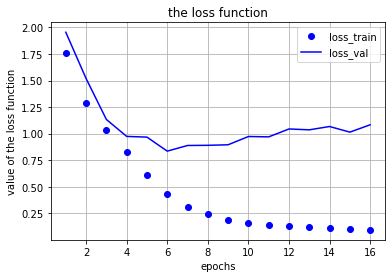

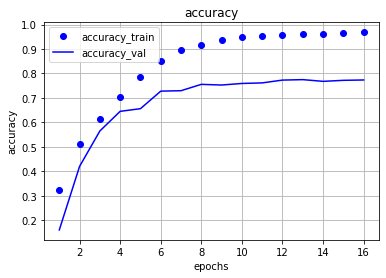

In [ ]:
func(history)

In [ ]:
rgb_test_images = np.repeat(test_image_array[..., np.newaxis], 3, -1)
test_images = rgb_test_images.reshape((rgb_test_images.shape[0], 48, 48, 3))
print(test_images.shape)
pred_test_labels = tpu_model.predict(test_images)
print(pred_test_labels[0])

(3533, 48, 48, 3)
[0. 0. 0. 0. 1. 0. 0.]


In [ ]:
from keras.models import load_model
 
tpu_model = load_model('/content/drive/MyDrive/NeuroBaby_FEC/models/NeuroBaby_V0_3.h5')

In [ ]:
pred_test_labels = tpu_model.predict(test_images)

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


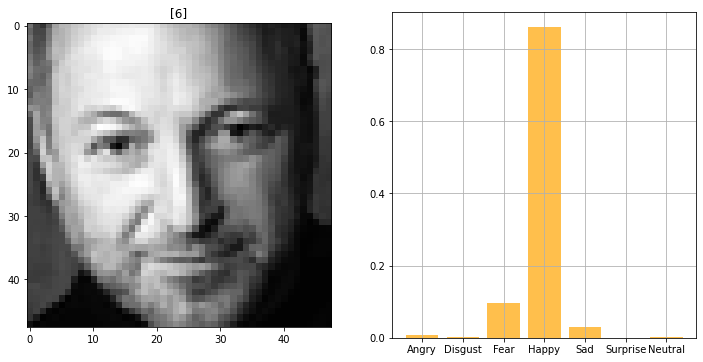

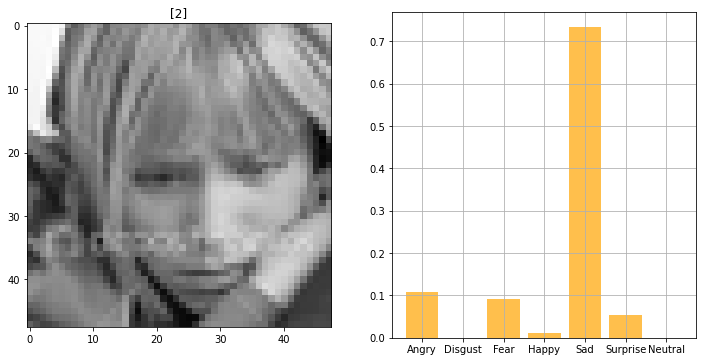

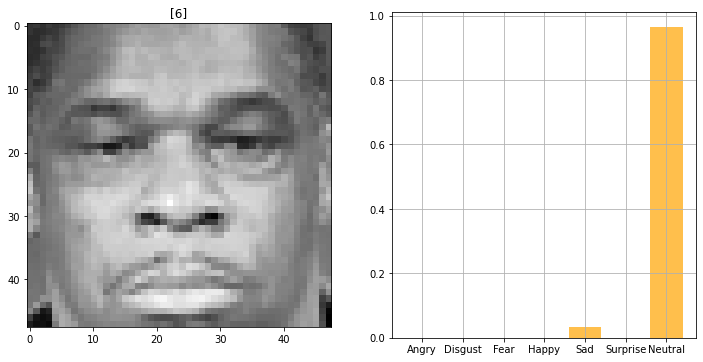

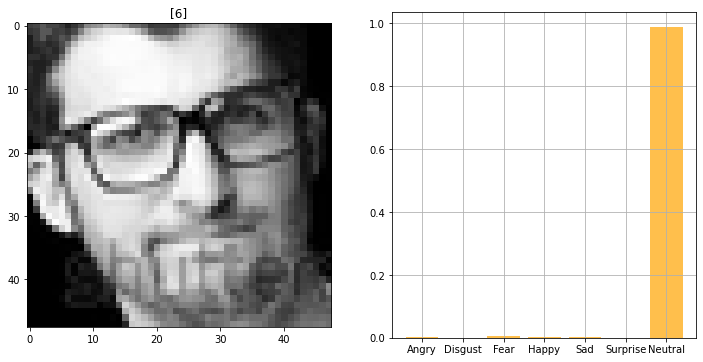

Exception ignored in: <function IteratorResourceDeleter.__del__ at 0x7f63c4b1e710>
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/iterator_ops.py", line 535, in __del__
    handle=self._handle, deleter=self._deleter)
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/ops/gen_dataset_ops.py", line 1267, in delete_iterator
    _ops.raise_from_not_ok_status(e, name)
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/ops.py", line 6862, in raise_from_not_ok_status
    six.raise_from(core._status_to_exception(e.code, message), None)
  File "<string>", line 3, in raise_from
tensorflow.python.framework.errors_impl.NotFoundError: Container AnonymousIterator does not exist. [Op:DeleteIterator]


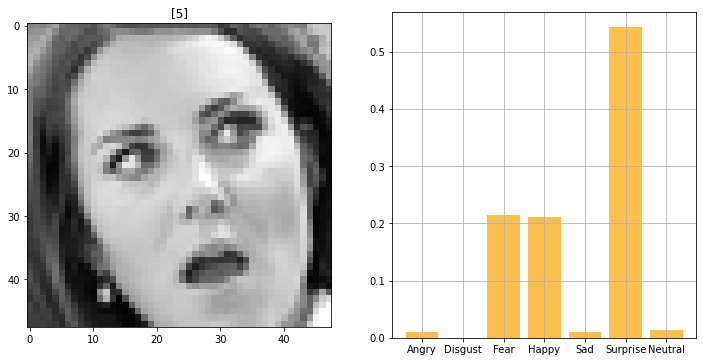

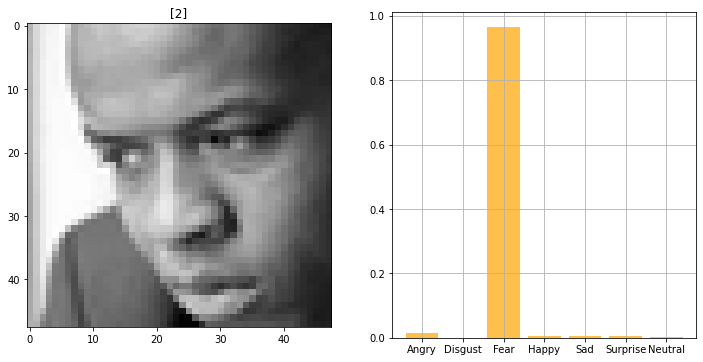

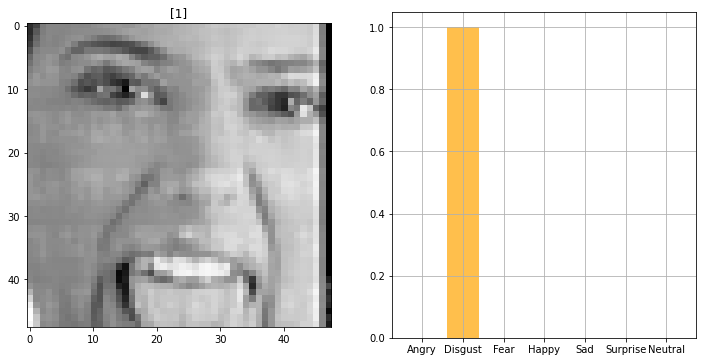

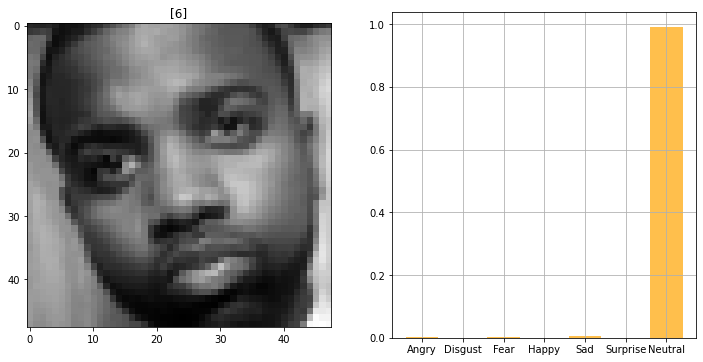

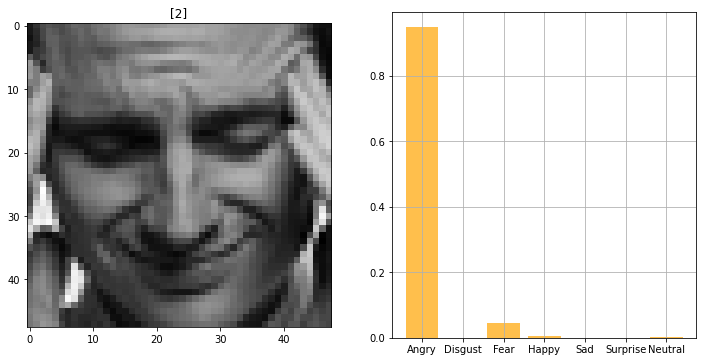

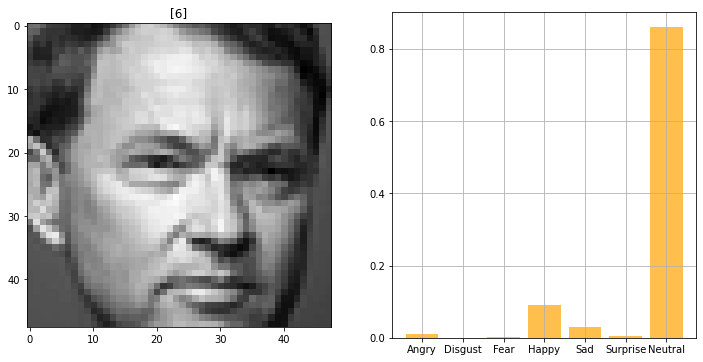

In [ ]:
print_facials(0, 10, 2)

In [ ]:
from PIL import Image, ImageDraw
import numpy as np


def converter(path):
    img = Image.open(path)
    arr = np.asarray(img, dtype='uint8')
    x, y, _ = arr.shape

    k = np.array([[[0.2989, 0.587, 0.114]]])
    arr2 = np.round(np.sum(arr * k, axis=2)).astype(np.uint8).reshape((x, y))

    img2 = Image.fromarray(arr2)
    img2.save('/content/drive/MyDrive/NeuroBaby_FEC/foto/result_bw.png')
    print(arr2.shape)

im = Image.open("/content/drive/MyDrive/NeuroBaby_FEC/foto/test_photo6.jpg")
size = (48, 48)
image = im.resize(size)
image.save("/content/drive/MyDrive/NeuroBaby_FEC/foto/test_photo_resized.png", "PNG")
converter('/content/drive/MyDrive/NeuroBaby_FEC/foto/test_photo_resized.png')

(48, 48)


In [ ]:
img = Image.open('/content/drive/MyDrive/NeuroBaby_FEC/foto/result_bw.png')
arr = np.asarray(img, dtype='uint8')
# arr = np.rot90(arr)
test_image = arr.reshape((1, 48, 48, 1))
test_arr = arr.reshape((1, 48, 48))
test_image = test_image.astype('float32')/255
test_pred = tpu_model.predict(test_image)

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


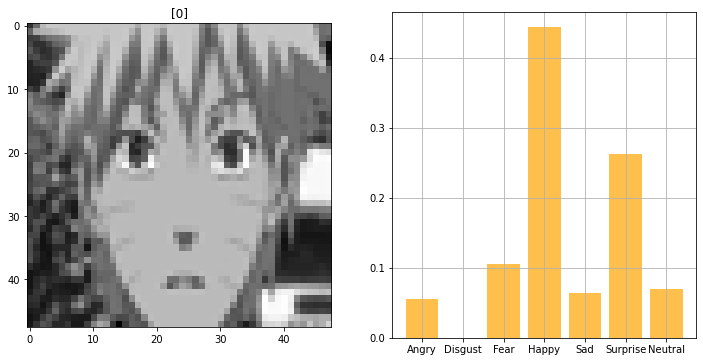

In [ ]:
plot_image_and_emotion(test_arr, test_image_label, test_pred, 0)

In [ ]:
pip install keract

In [ ]:
from keract import get_activations

activations = get_activations(create_model_7(), test_image, auto_compile=True)

conv2d_12_input (1, 48, 48, 1) 


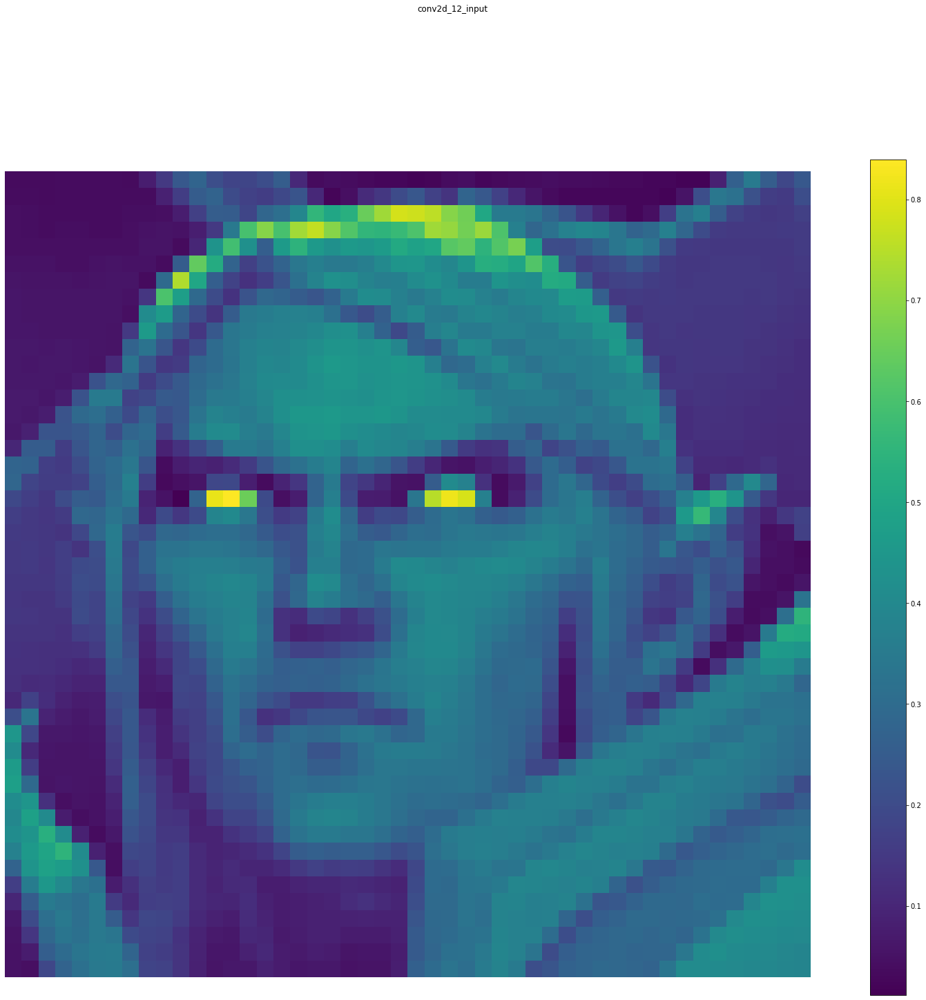

conv2d_12 (1, 48, 48, 64) 


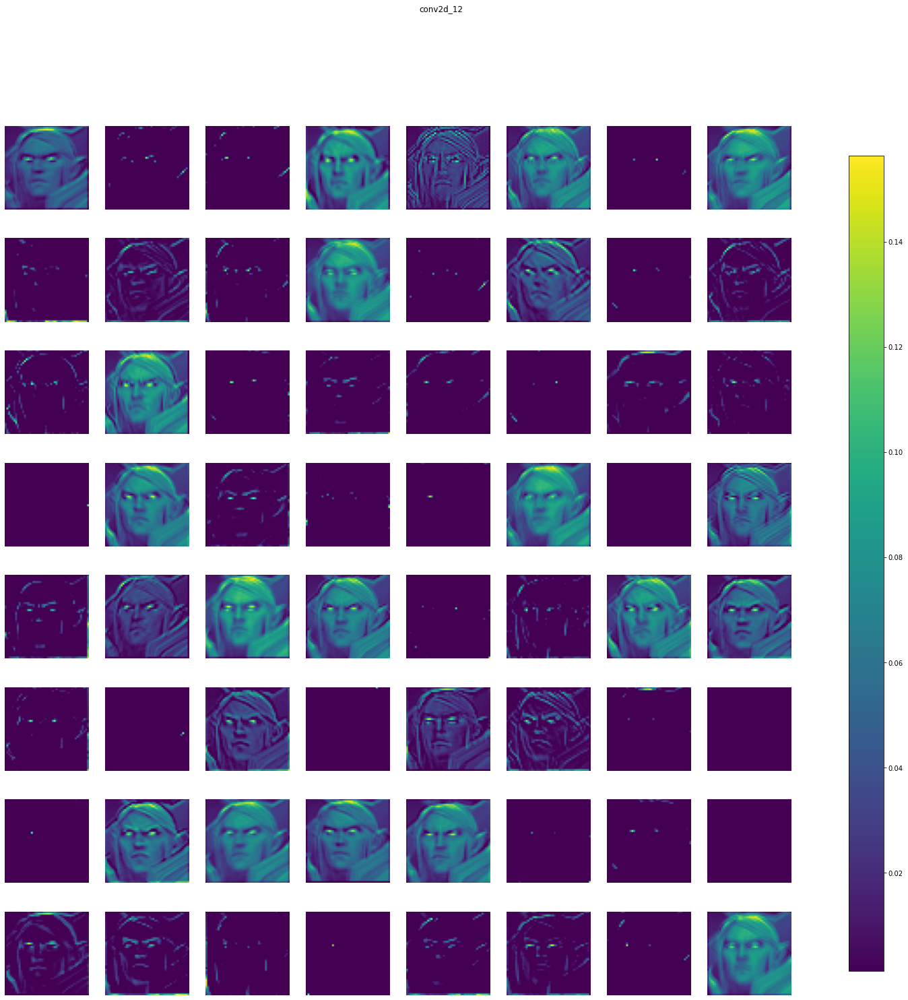

batch_normalization_20 (1, 48, 48, 64) 


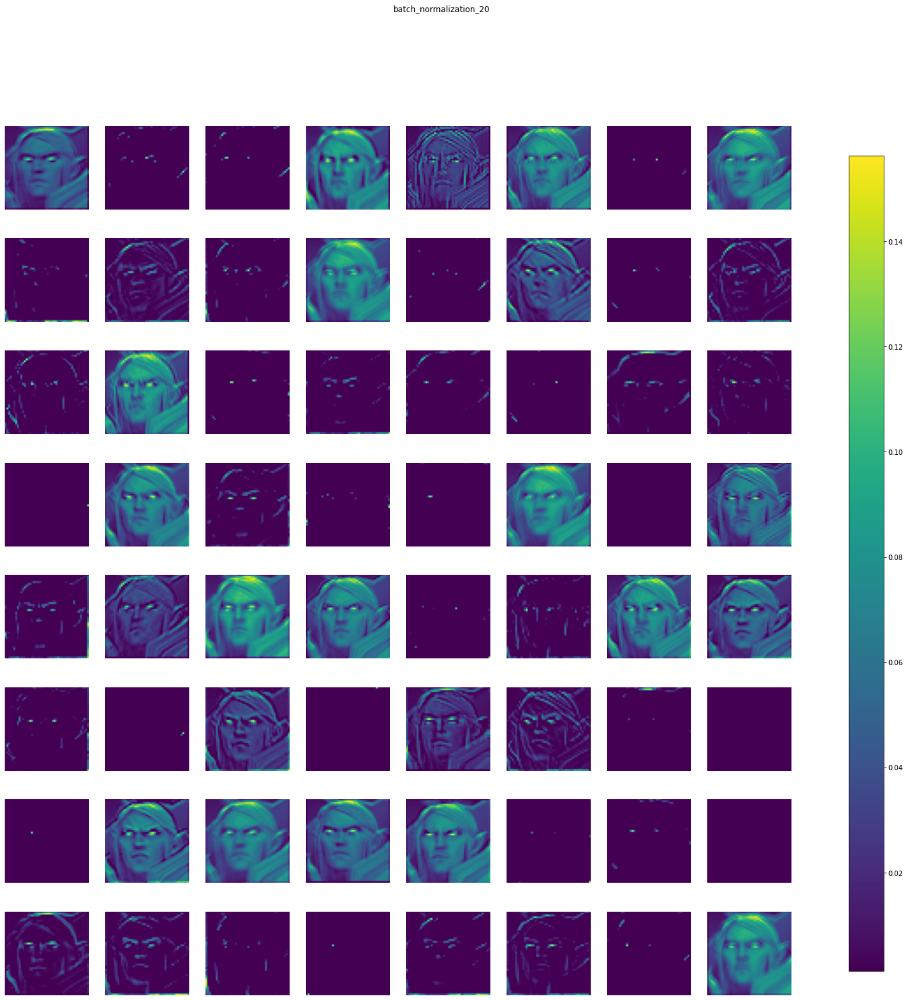

dropout_20 (1, 48, 48, 64) 


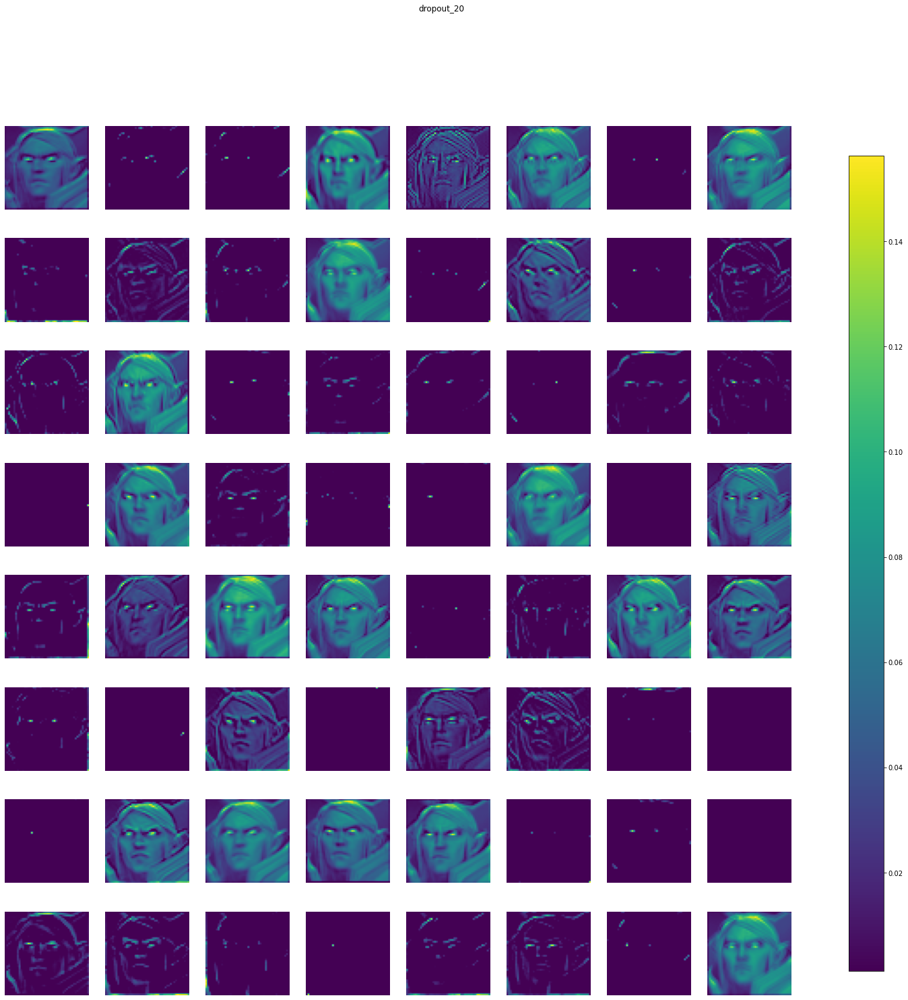

conv2d_13 (1, 48, 48, 128) 


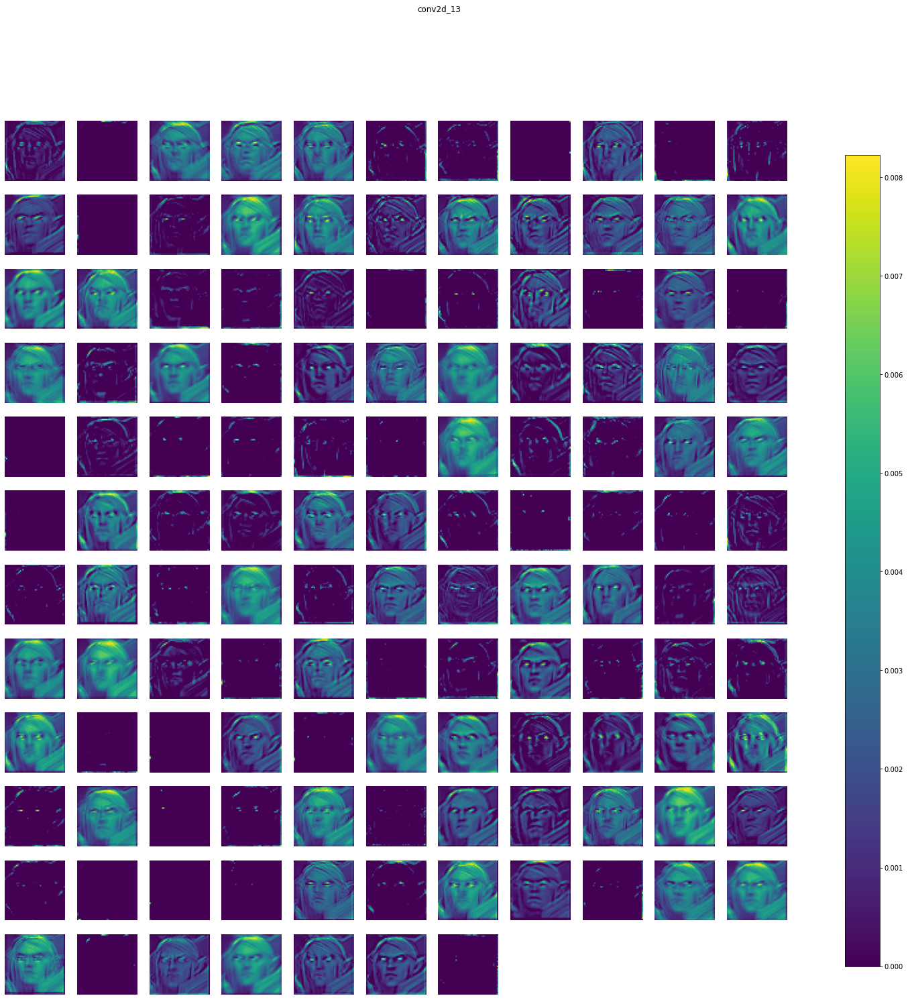

batch_normalization_21 (1, 48, 48, 128) 


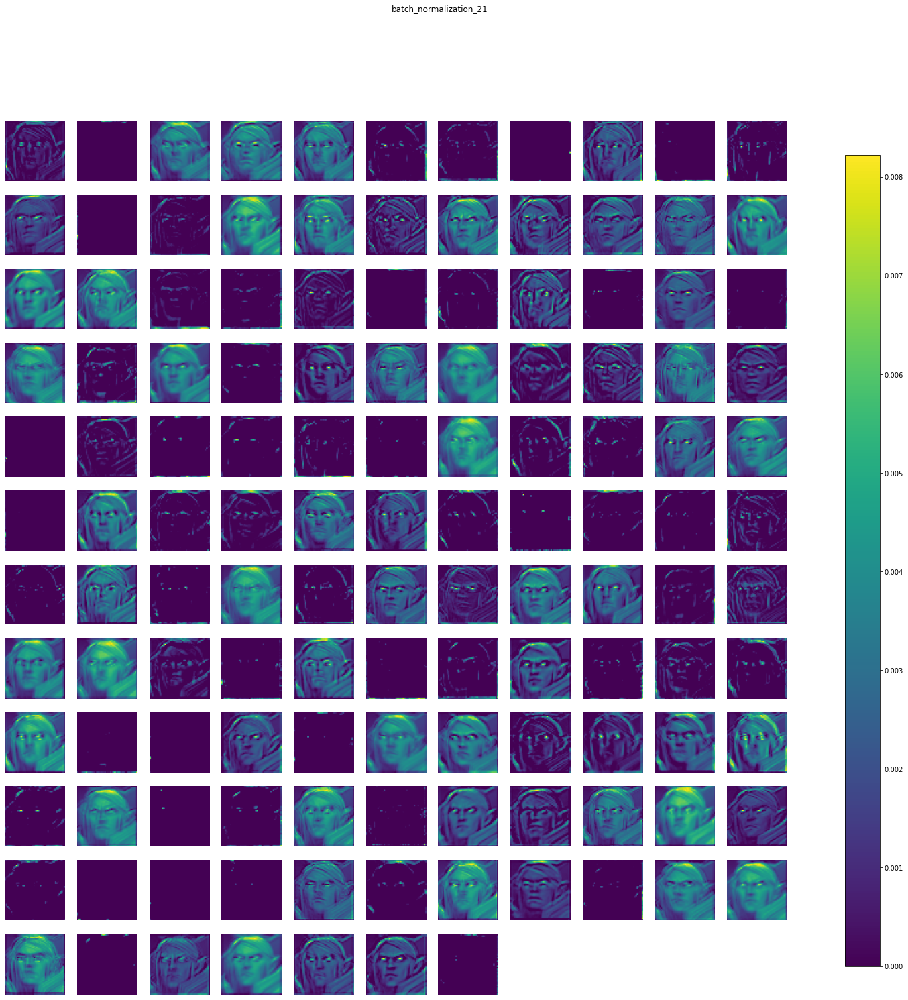

dropout_21 (1, 48, 48, 128) 


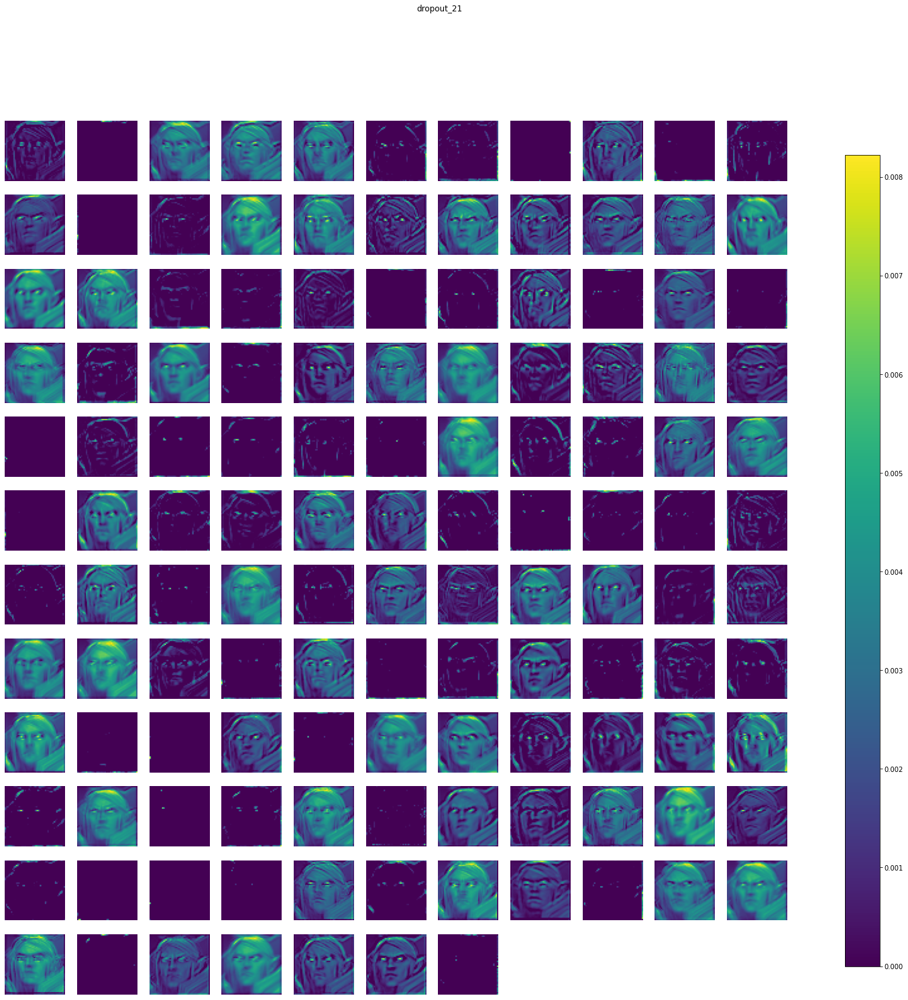

conv2d_14 (1, 48, 48, 256) 


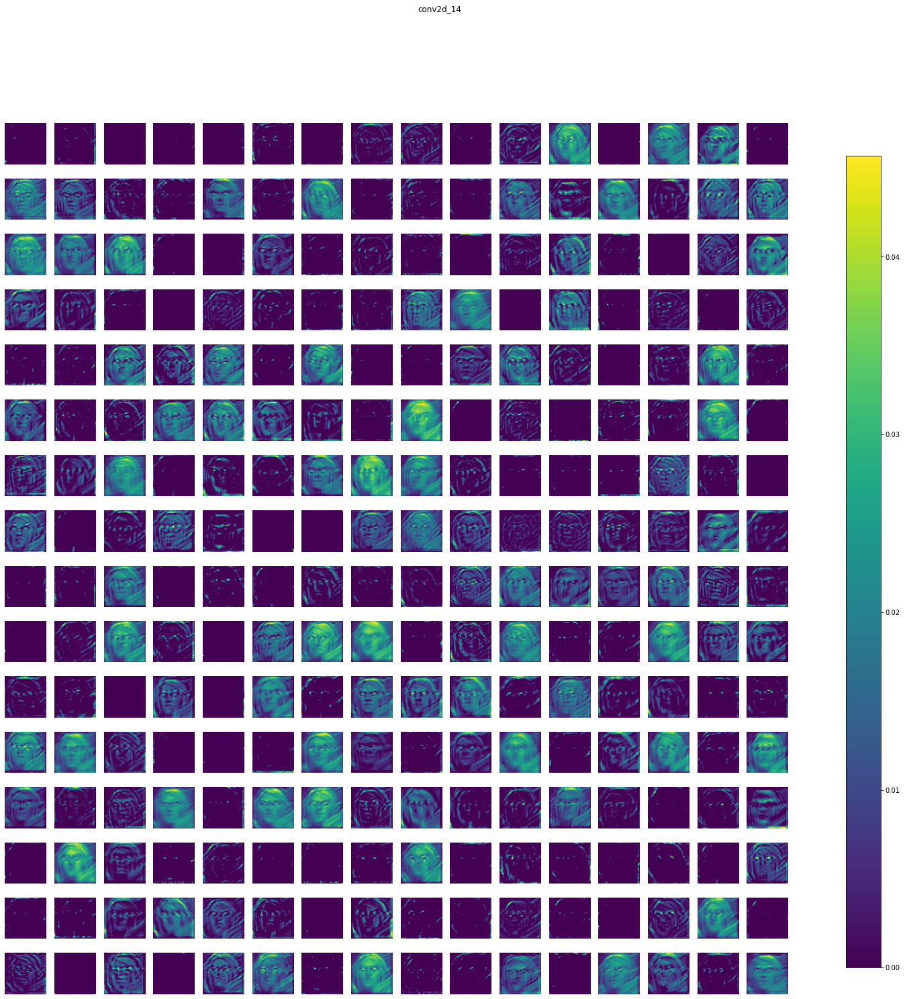

batch_normalization_22 (1, 48, 48, 256) 


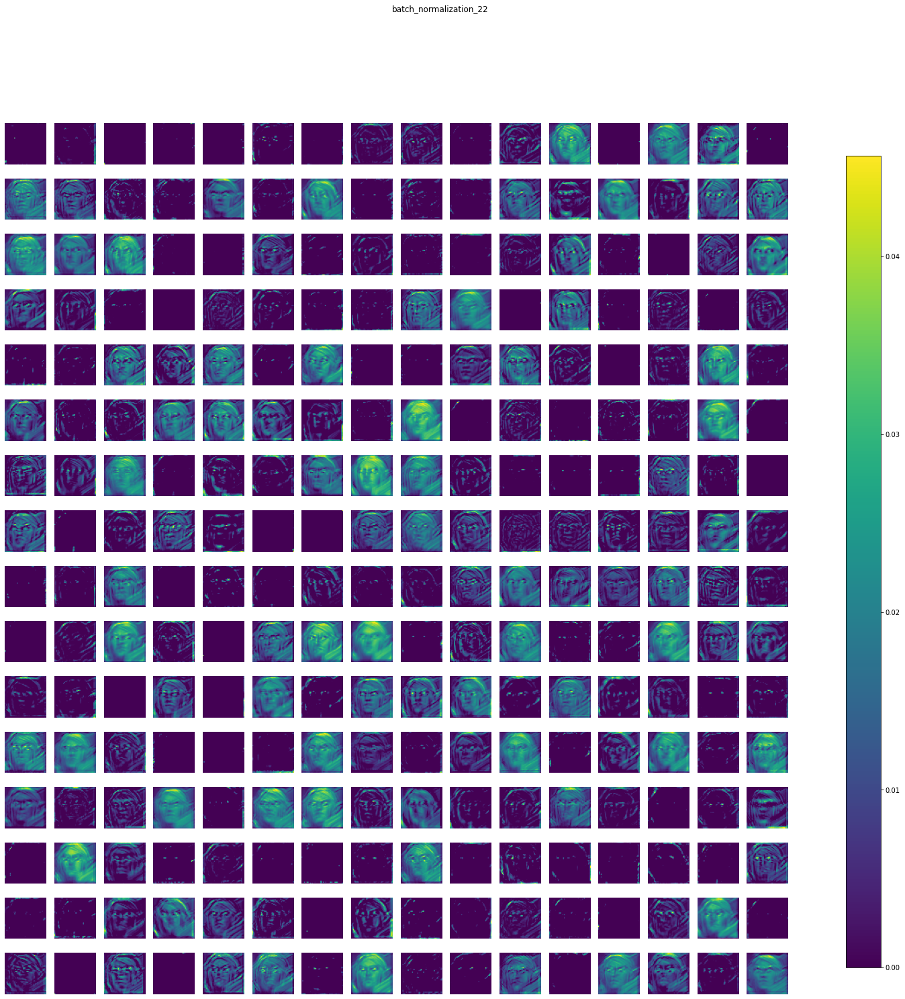

max_pooling2d_4 (1, 24, 24, 256) 


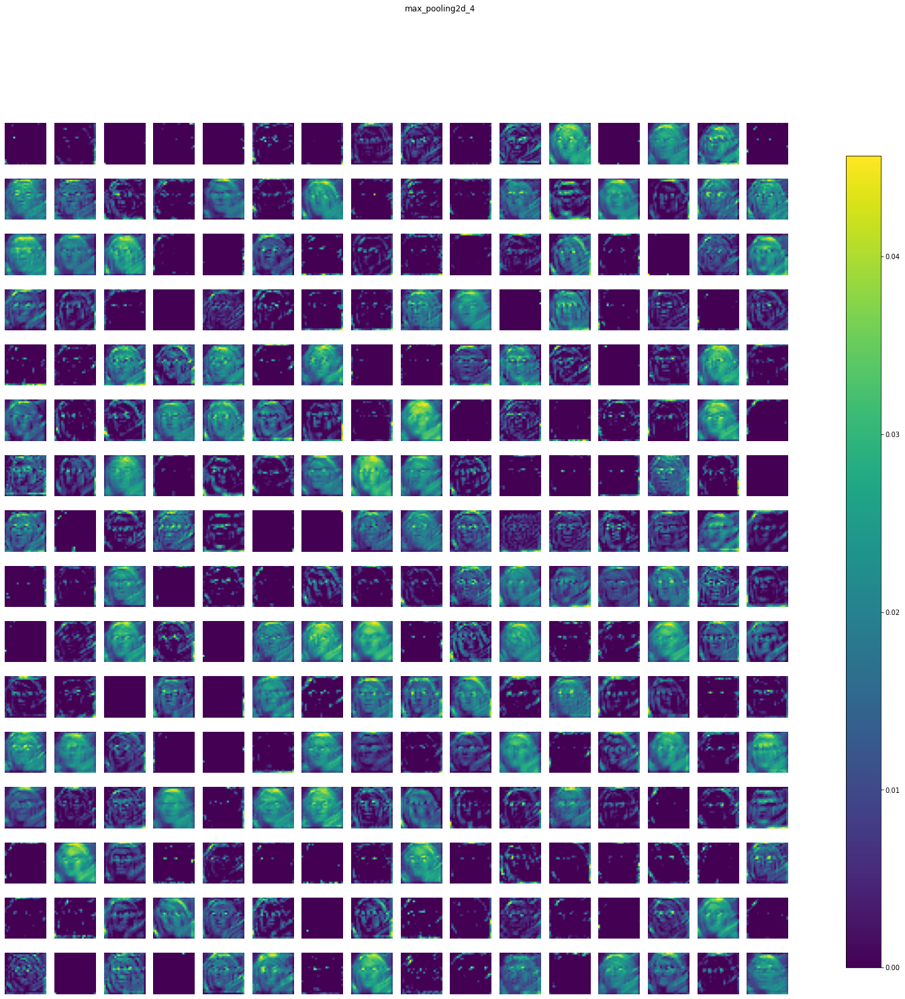

dropout_22 (1, 24, 24, 256) 


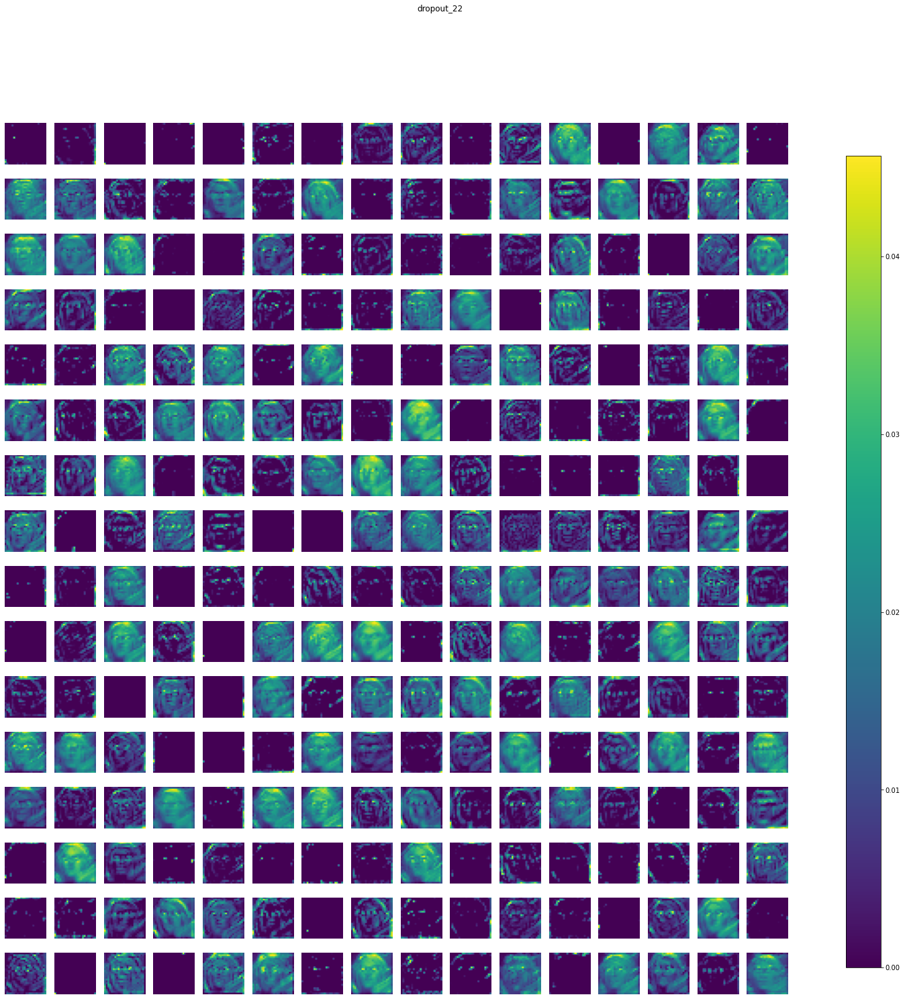

flatten_4 (1, 147456) 


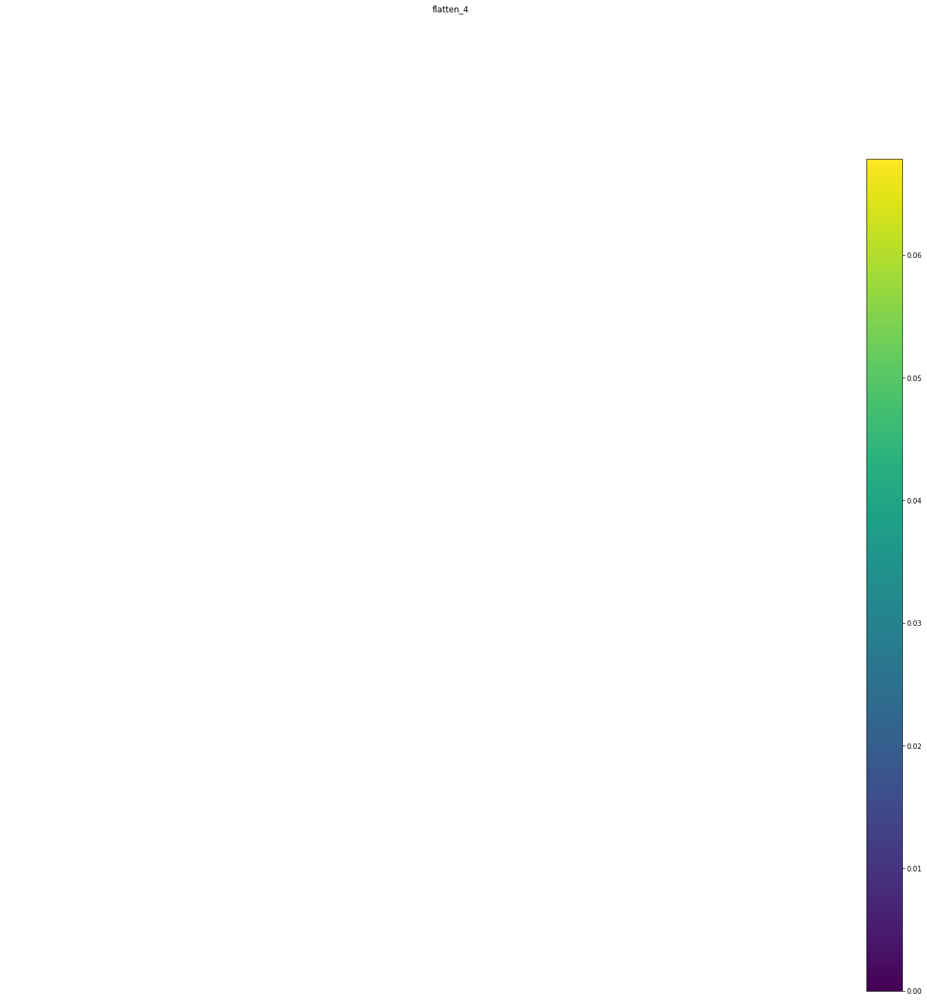

dense_12 (1, 128) 


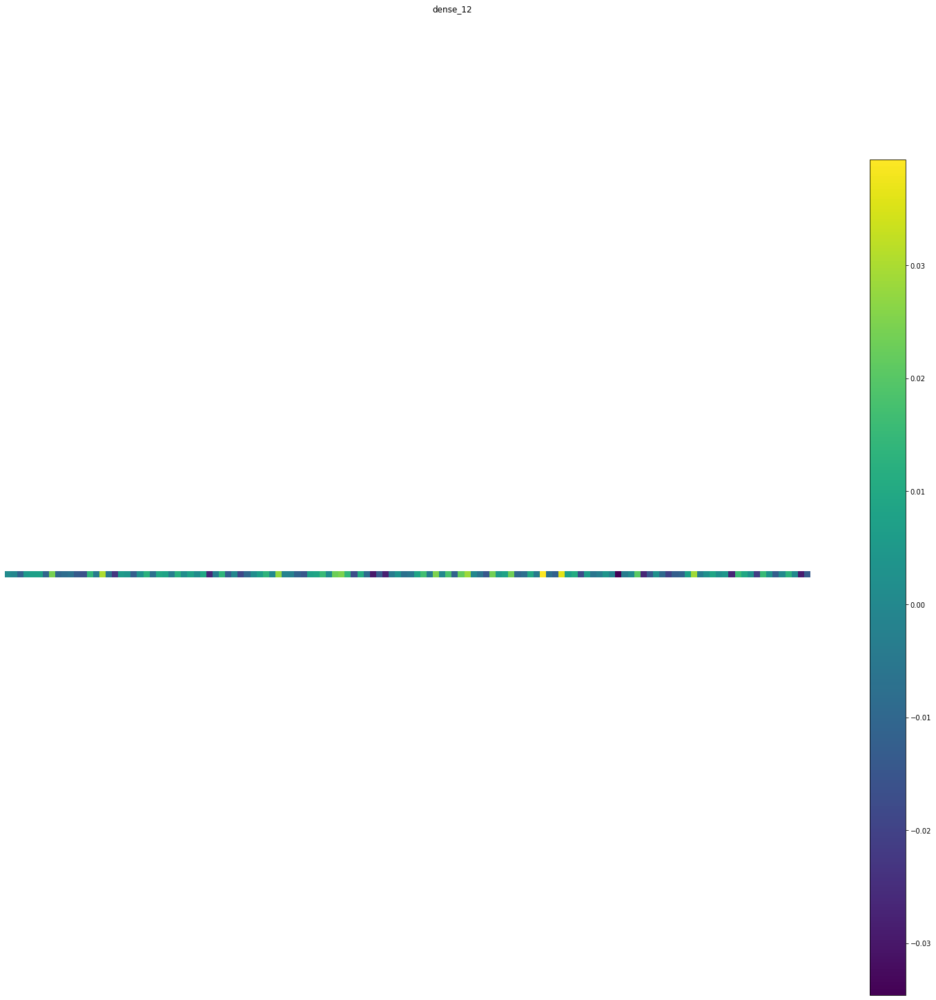

batch_normalization_23 (1, 128) 


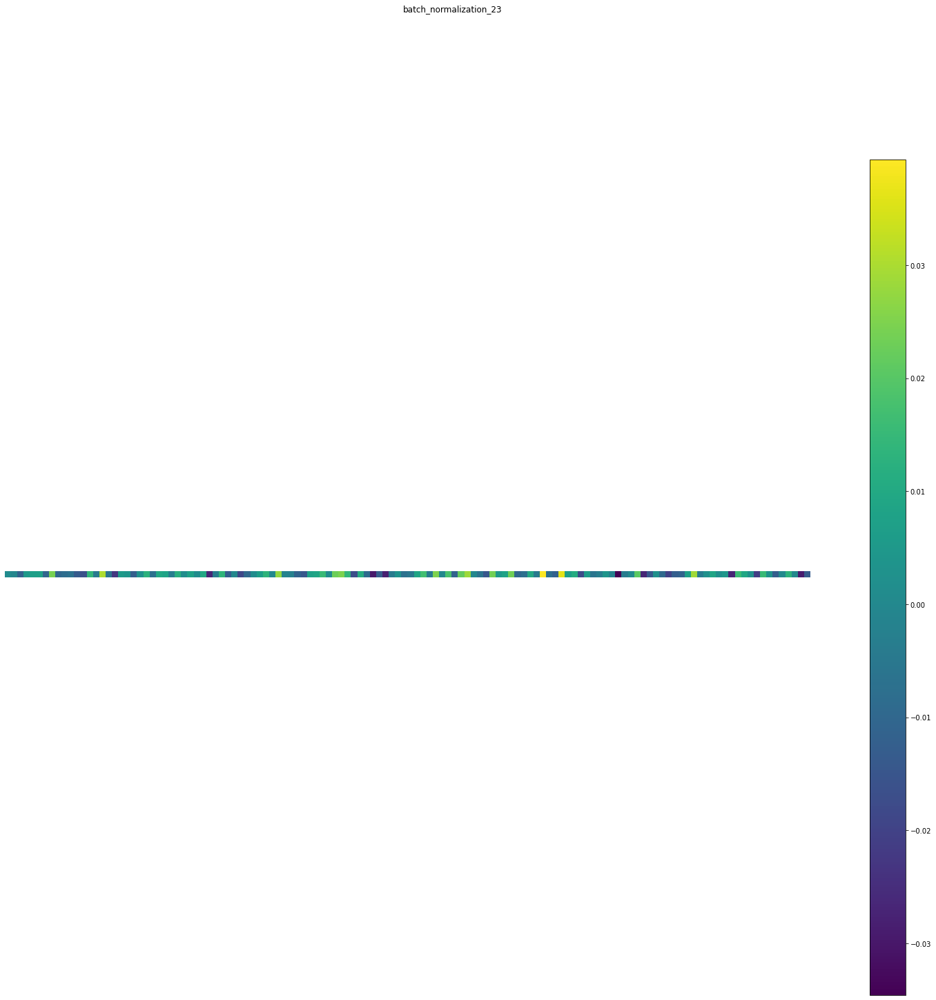

activation_8 (1, 128) 


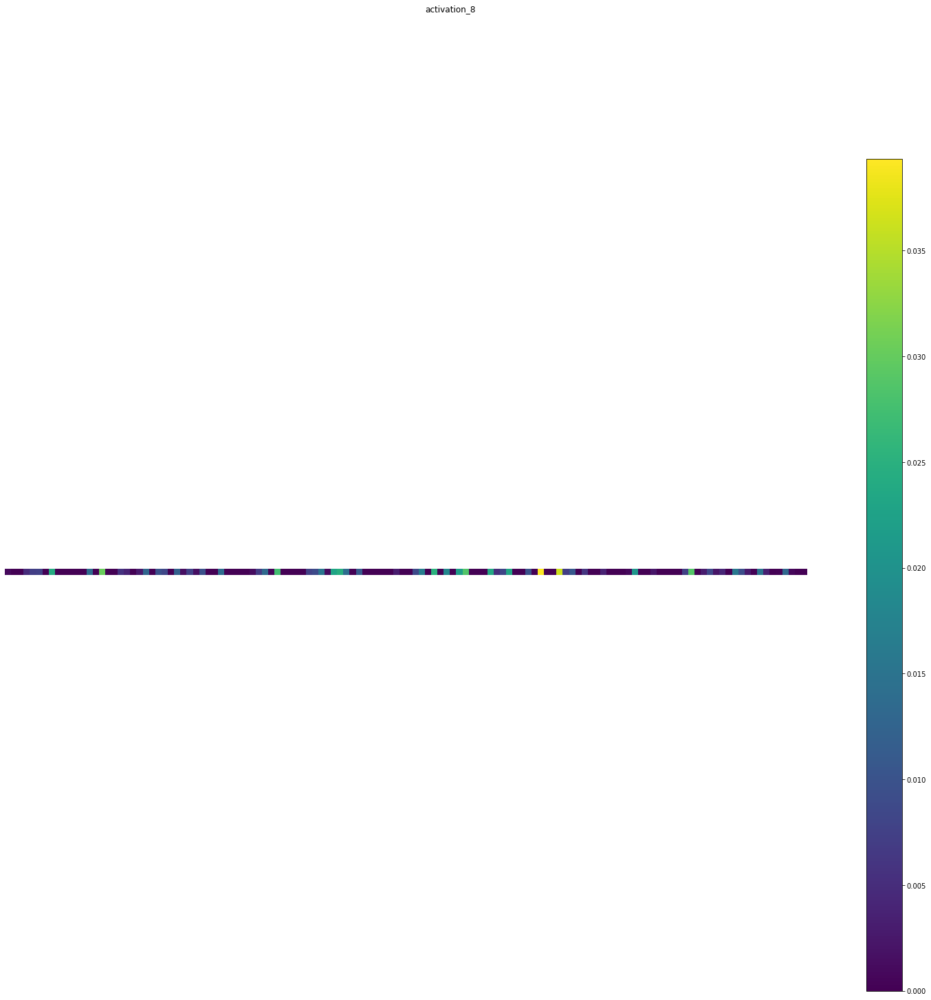

dropout_23 (1, 128) 


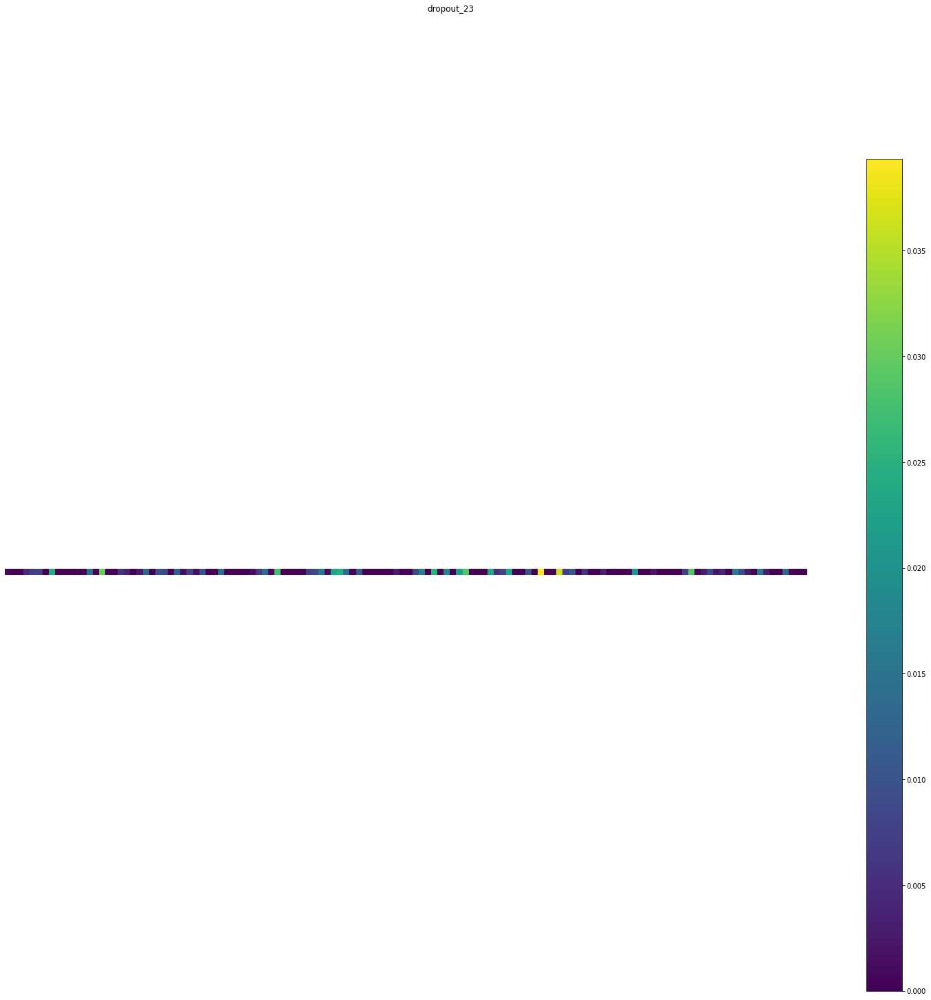

dense_13 (1, 256) 


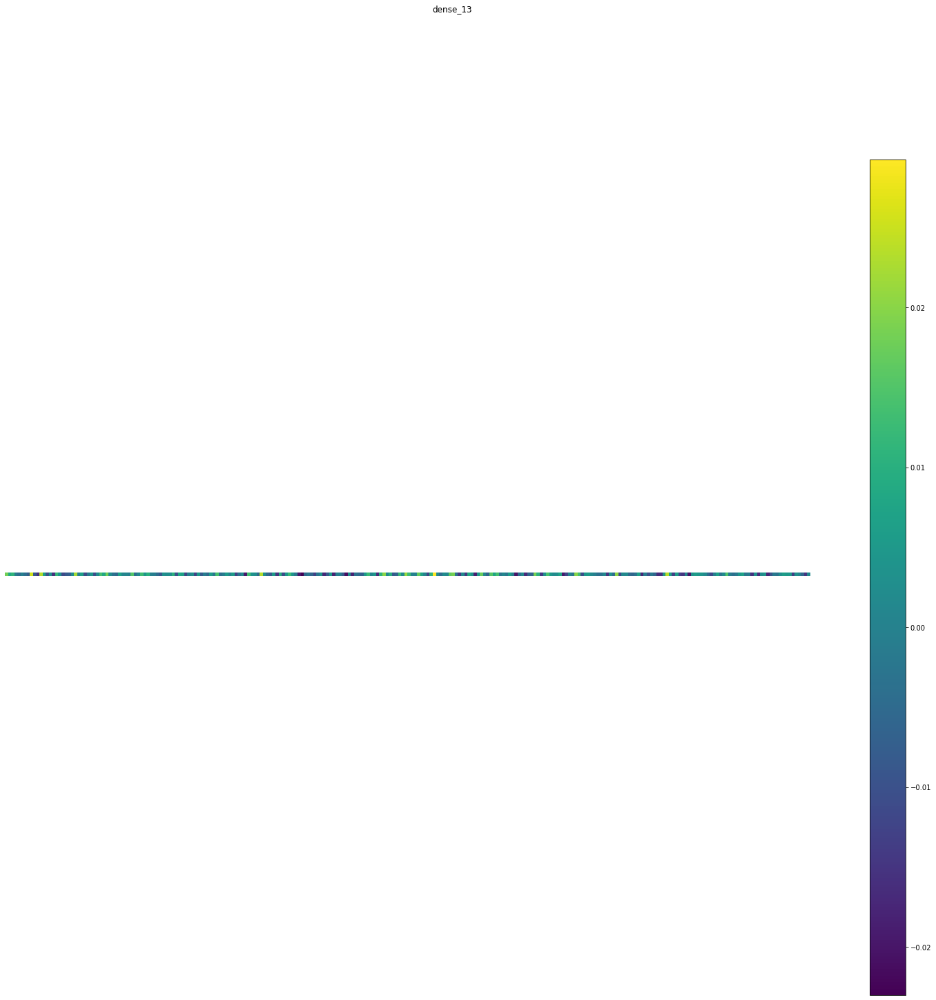

batch_normalization_24 (1, 256) 


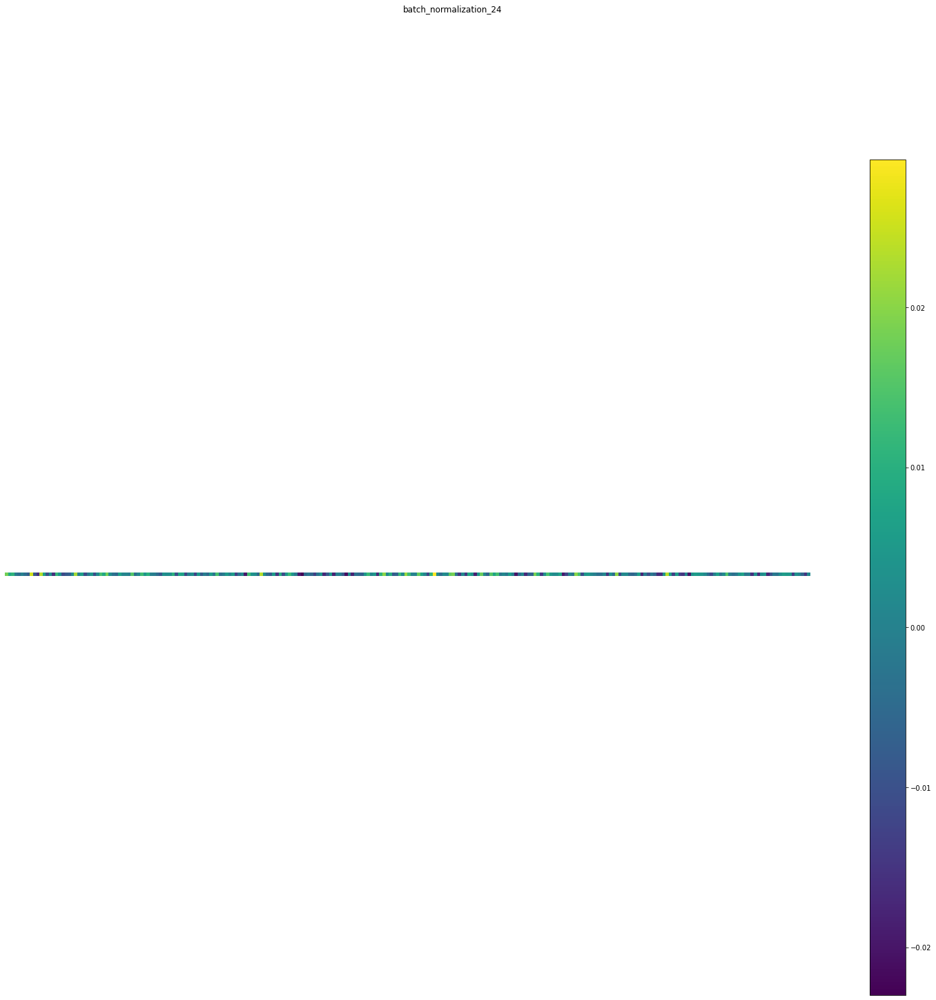

activation_9 (1, 256) 


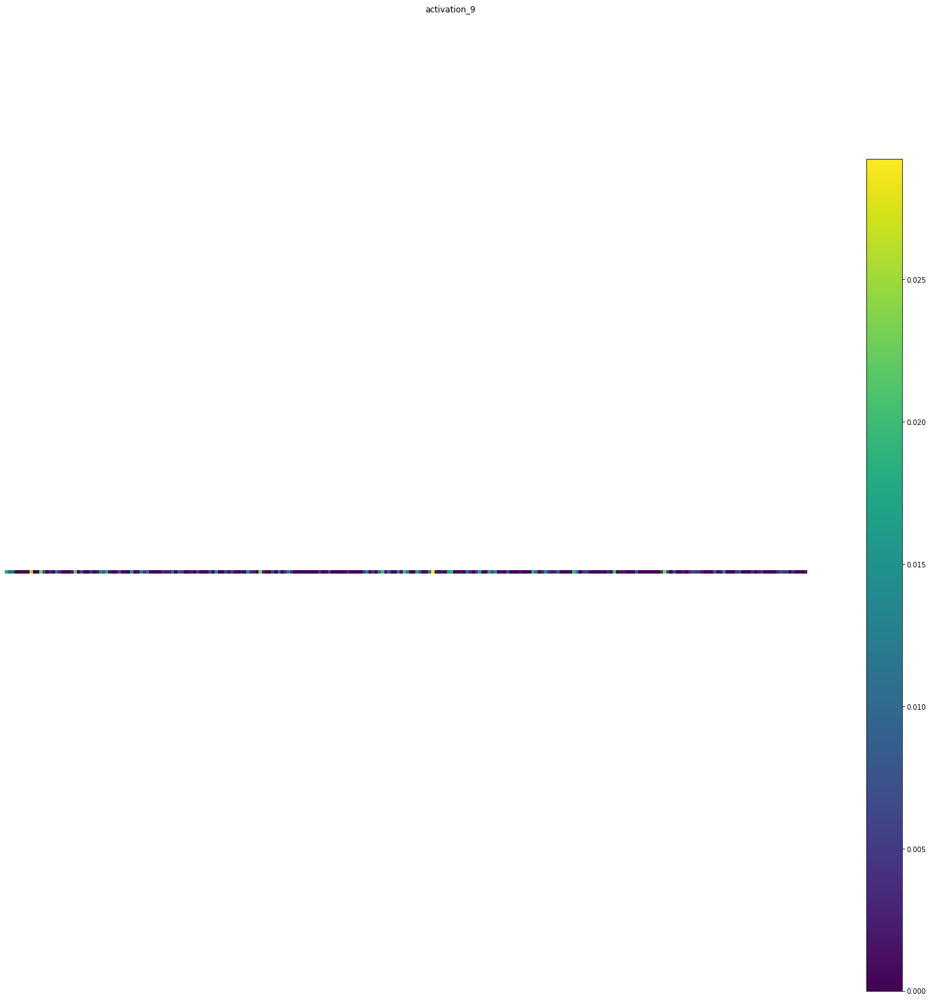

dropout_24 (1, 256) 


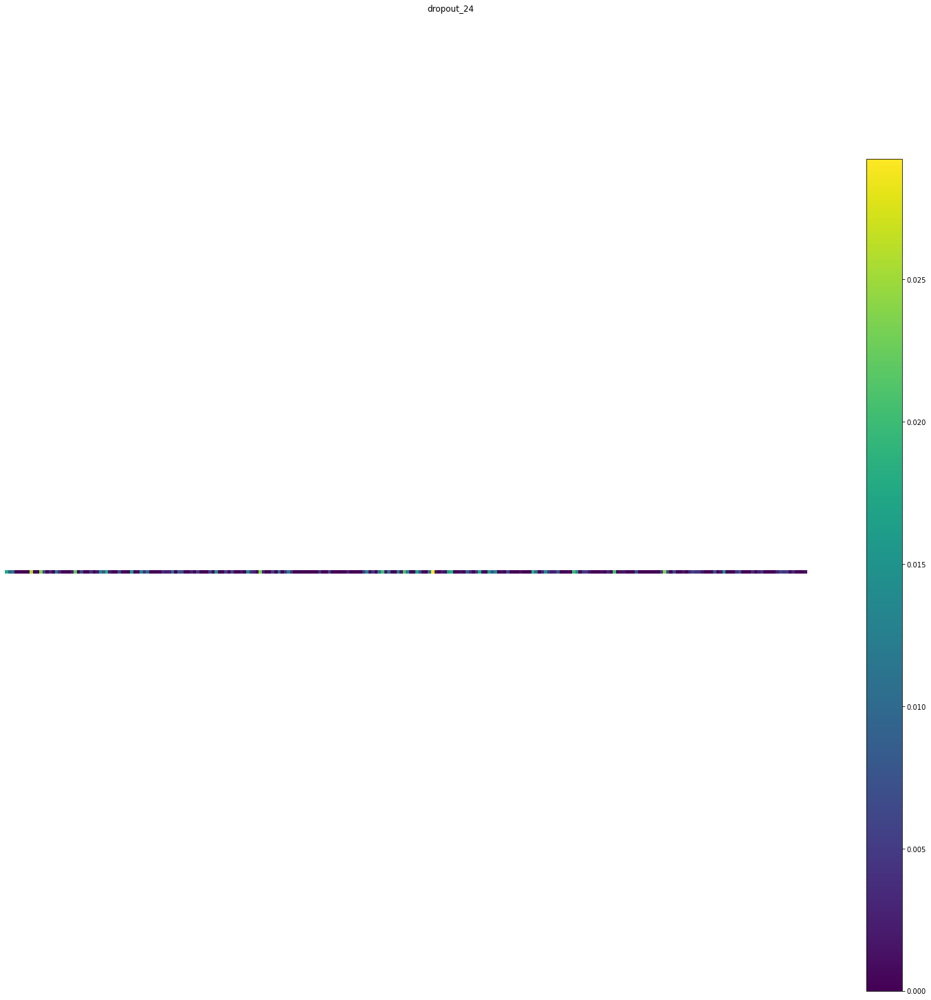

dense_14 (1, 7) 


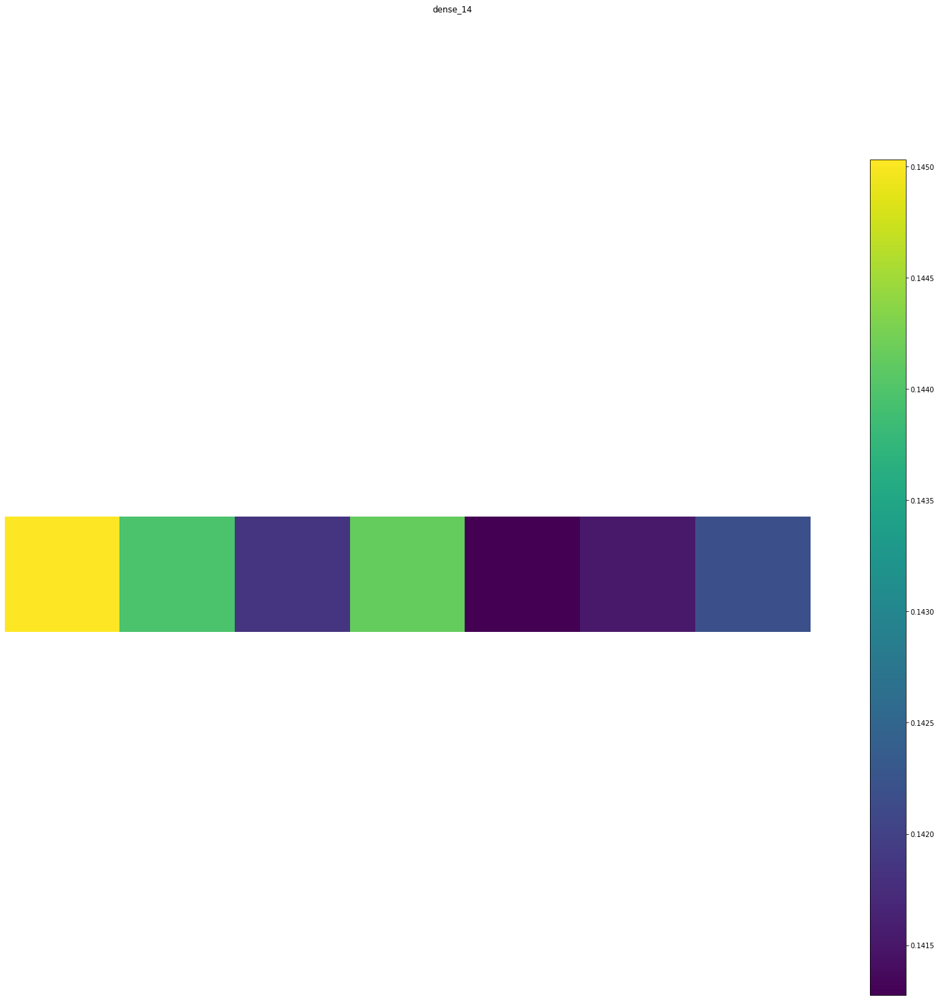

In [ ]:
import keract

keract.display_activations(activations, cmap=None, save=False, directory='.', data_format='channels_last', fig_size=(24, 24), reshape_1d_layers=False)

conv2d_12_input (1, 48, 48, 1) 


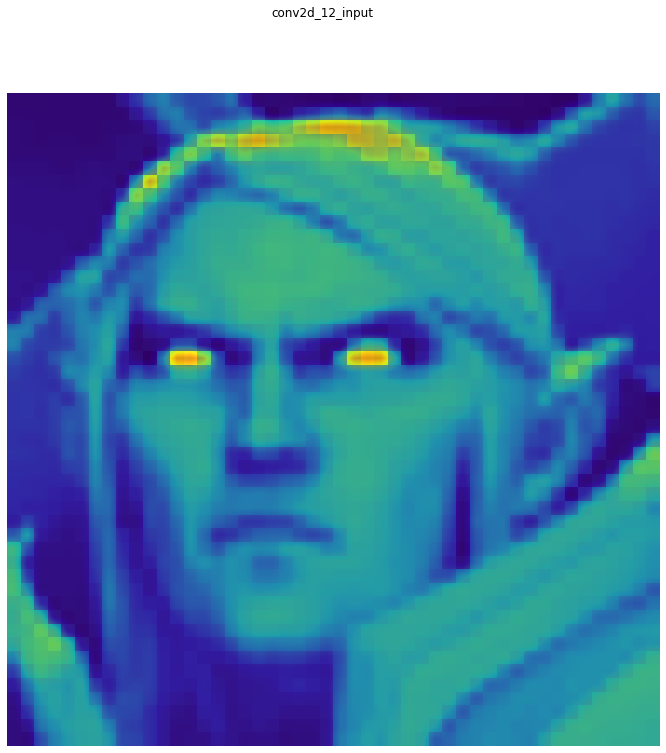

conv2d_12 (1, 48, 48, 64) 


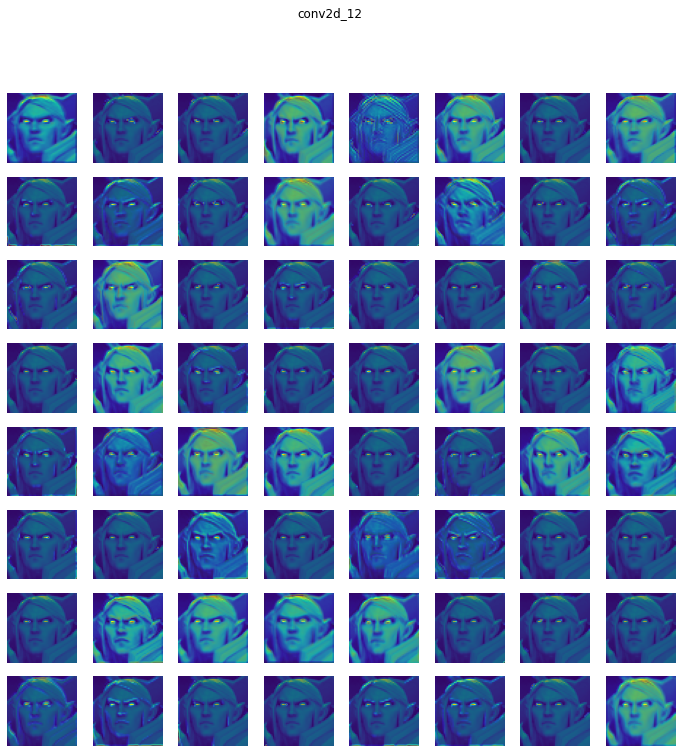

batch_normalization_20 (1, 48, 48, 64) 


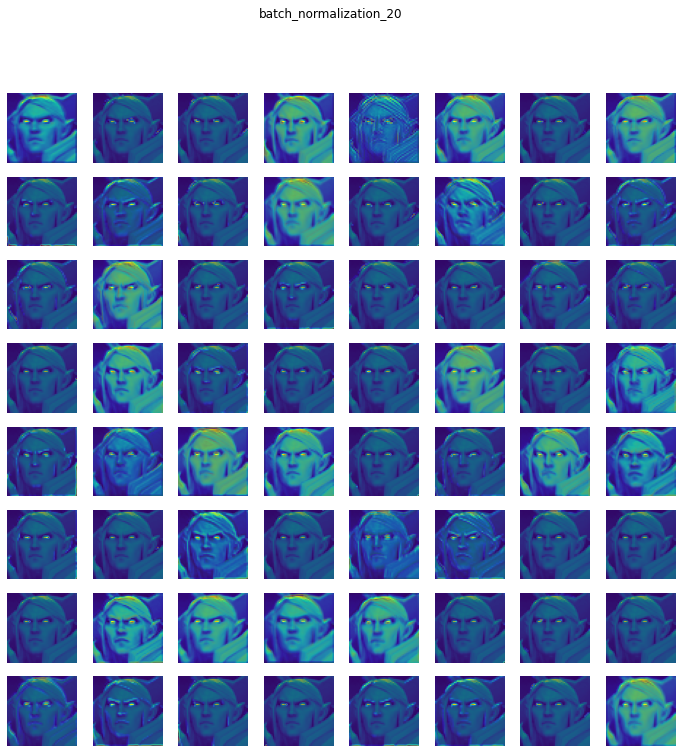

dropout_20 (1, 48, 48, 64) 


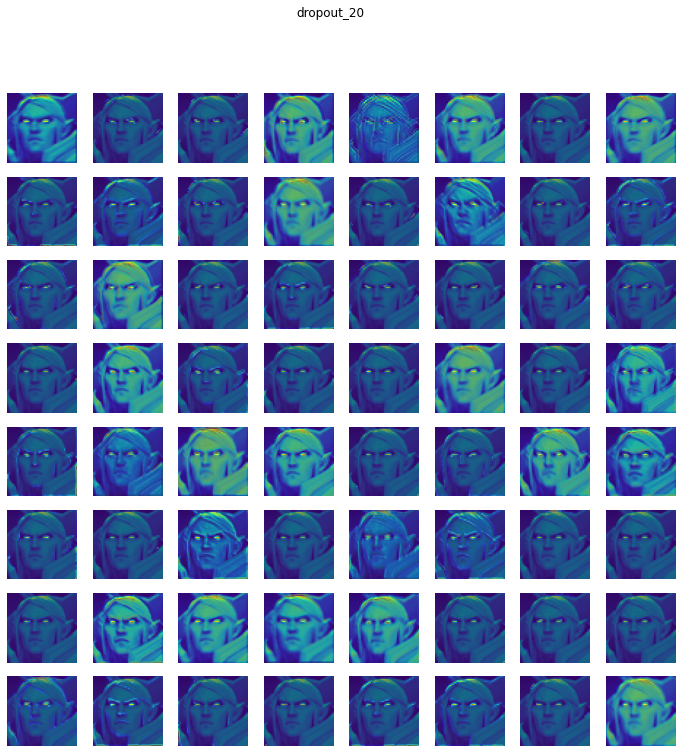

conv2d_13 (1, 48, 48, 128) 


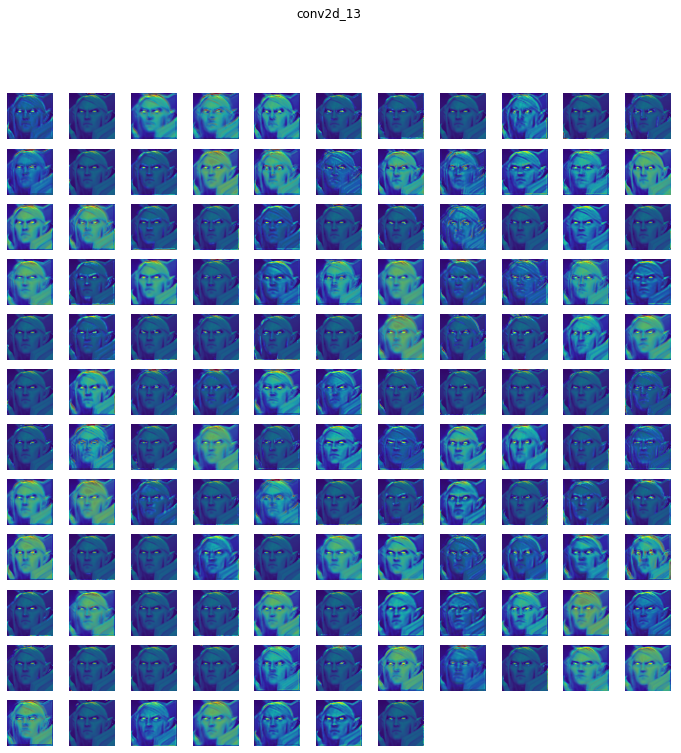

batch_normalization_21 (1, 48, 48, 128) 


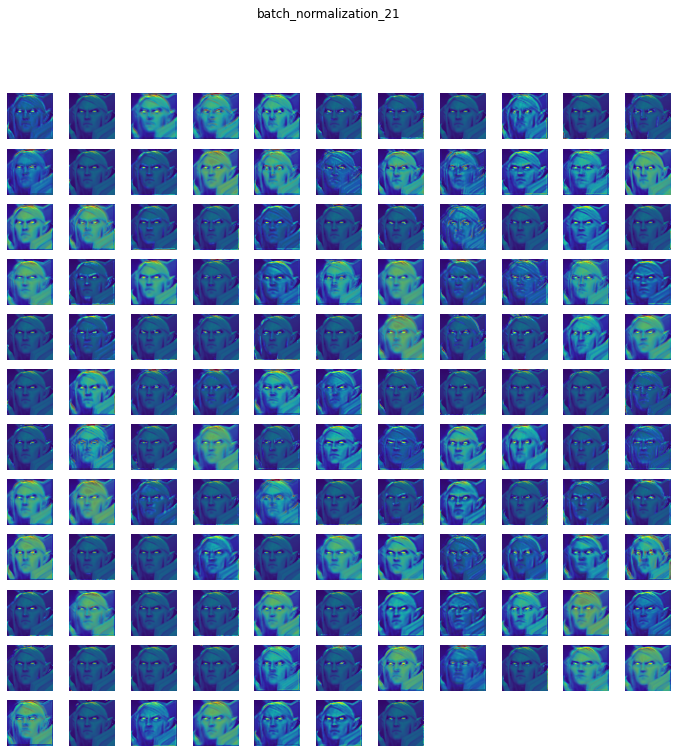

dropout_21 (1, 48, 48, 128) 


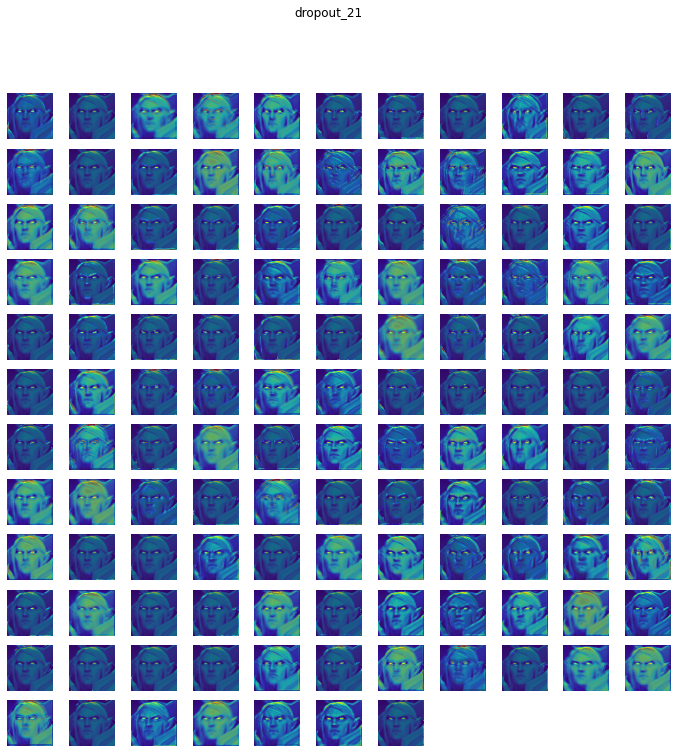

conv2d_14 (1, 48, 48, 256) 


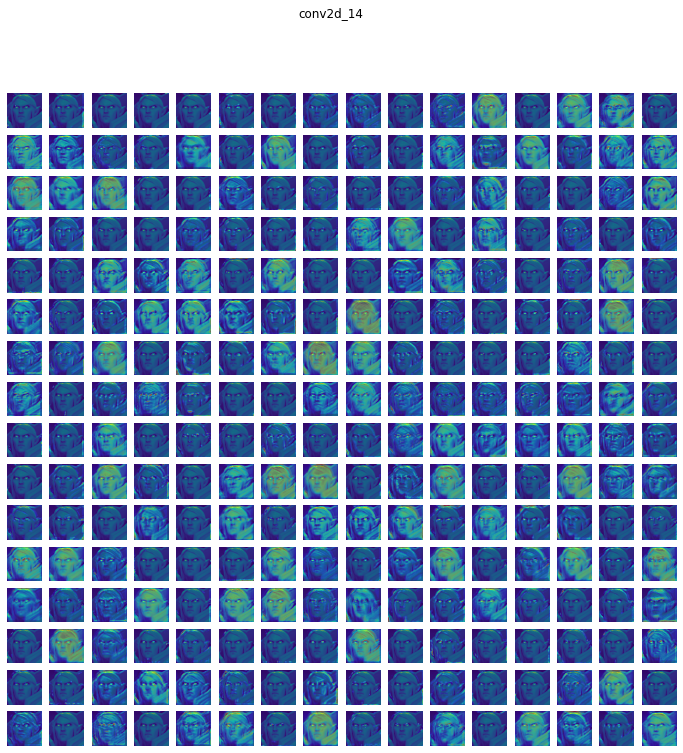

batch_normalization_22 (1, 48, 48, 256) 


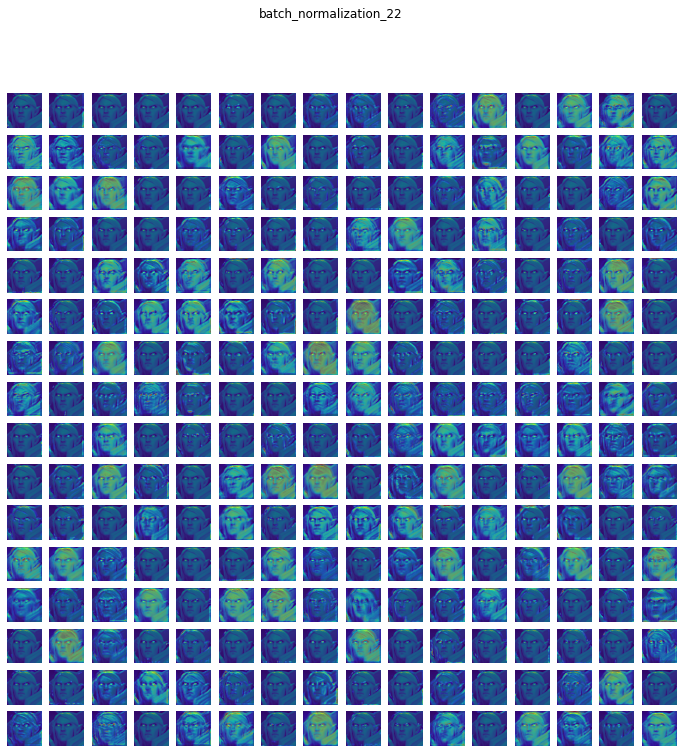

max_pooling2d_4 (1, 24, 24, 256) 


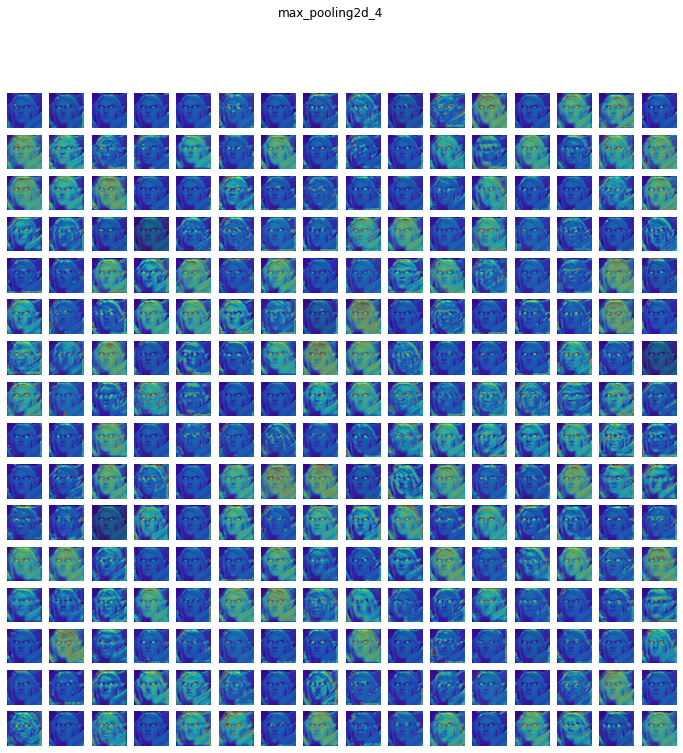

dropout_22 (1, 24, 24, 256) 


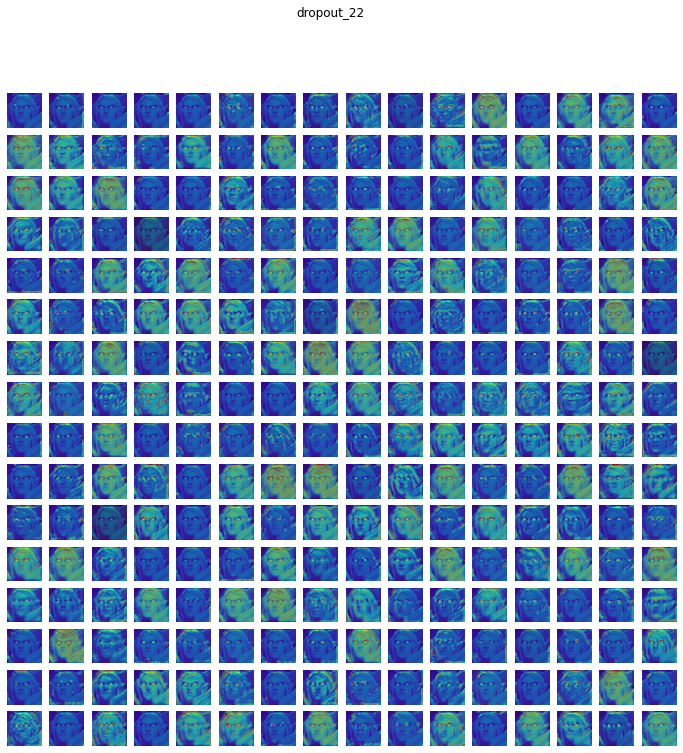

flatten_4 (1, 147456) -> Skipped. 2D Activations.
dense_12 (1, 128) -> Skipped. 2D Activations.
batch_normalization_23 (1, 128) -> Skipped. 2D Activations.
activation_8 (1, 128) -> Skipped. 2D Activations.
dropout_23 (1, 128) -> Skipped. 2D Activations.
dense_13 (1, 256) -> Skipped. 2D Activations.
batch_normalization_24 (1, 256) -> Skipped. 2D Activations.
activation_9 (1, 256) -> Skipped. 2D Activations.
dropout_24 (1, 256) -> Skipped. 2D Activations.
dense_14 (1, 7) -> Skipped. 2D Activations.


In [ ]:
keract.display_heatmaps(activations, test_image, save=False)

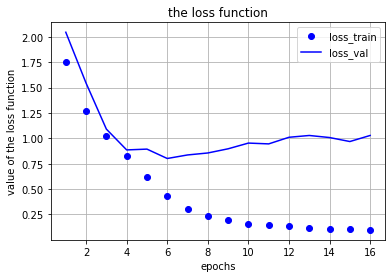

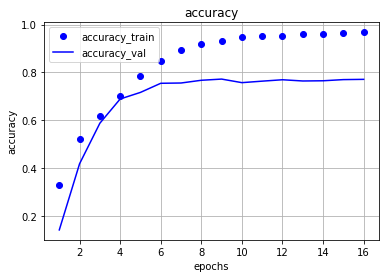

In [ ]:
with open('/content/drive/MyDrive/NeuroBaby_FEC/history/trainHistoryDictNB_V0_3', 'rb') as file_pi:
        hist = pickle.load(file_pi)
loss =  hist['loss']
loss_val = hist['val_loss']
epochs = range(1, len(loss)+1)
plt.plot(epochs, loss, 'bo', label='loss_train')
plt.plot(epochs, loss_val, 'b', label='loss_val')
plt.title('the loss function')
plt.xlabel('epochs')
plt.ylabel('value of the loss function')
plt.legend()
plt.grid()
plt.show()
 
acc = hist['accuracy']
acc_val = hist['val_accuracy']
epochs = range(1, len(loss)+1)
plt.plot(epochs, acc, 'bo', label='accuracy_train')
plt.plot(epochs, acc_val, 'b', label='accuracy_val')
plt.title('accuracy')
plt.xlabel('epochs')
plt.ylabel('accuracy')
plt.legend()
plt.grid()
plt.show()

In [ ]:
model = load_model('/content/drive/MyDrive/NeuroBaby_FEC/models/NeuroBaby_V0_3.h5')
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 48, 48, 64)        640       
_________________________________________________________________
batch_normalization (BatchNo (None, 48, 48, 64)        256       
_________________________________________________________________
dropout (Dropout)            (None, 48, 48, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 48, 48, 128)       73856     
_________________________________________________________________
batch_normalization_1 (Batch (None, 48, 48, 128)       512       
_________________________________________________________________
dropout_1 (Dropout)          (None, 48, 48, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 48, 48, 256)       8

In [ ]:
dataset_path = "/content/drive/MyDrive/NeuroPeople/icml_face_data.csv"
 
data = pd.read_csv(dataset_path)
 
emotions = {
    0: 'Angry', 
    1: 'Disgust', 
    2: 'Fear', 
    3: 'Happy', 
    4: 'Sad', 
    5: 'Surprise', 
    6: 'Neutral'
}
def prepare_data(data):
    """ Prepare data for modeling 
        input: data frame with labels und pixel data
        output: image and label array """
    
    image_array = np.zeros(shape=(len(data), 48, 48))
    image_label = np.array(list(map(int, data['emotion'])))
    
    for i, row in enumerate(data.index):
        image = np.fromstring(data.loc[row, ' pixels'], dtype=int, sep=' ')
        image = np.reshape(image, (48, 48))
        image_array[i] = image
        
    return image_array, image_label 
 
def plot_image_and_emotion(test_image_array, test_image_label, pred_test_labels, image_number):
    """ Function to plot the image and compare the prediction results with the label """
    
    fig, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=False)
    
    bar_label = emotions.values()
    
    axs[0].imshow(test_image_array[image_number], 'gray')
    axs[0].set_title(emotions[test_image_label[image_number]])
    
    axs[1].bar(bar_label, pred_test_labels[image_number], color='orange', alpha=0.7)
    axs[1].grid()
    
    plt.show()
train_image_array, train_image_label = prepare_data(data[data[' Usage']=='Training'])
val_image_array, val_image_label = prepare_data(data[data[' Usage']=='PrivateTest'])
test_image_array, test_image_label = prepare_data(data[data[' Usage']=='PublicTest'])
train_images = train_image_array.reshape((train_image_array.shape[0], 48, 48, 1))
train_images = train_images.astype('float32')/255
val_images = val_image_array.reshape((val_image_array.shape[0], 48, 48, 1))
val_images = val_images.astype('float32')/255
test_images = test_image_array.reshape((test_image_array.shape[0], 48, 48, 1))
test_images = test_images.astype('float32')/255
train_labels = to_categorical(train_image_label)
val_labels = to_categorical(val_image_label)
test_labels = to_categorical(test_image_label)

def activ_model_pred(num_layer):
  activation_model = Model(inputs=model.input, outputs=model.layers[num_layer].output)
  return activation_model.predict(test_images)
 
def print_layers_vision(activation, image_num):
  images_per_row = 8
  n_filters = activation.shape[-1]
  size = activation.shape[1]
  n_cols = n_filters // images_per_row
 
  display_grid = np.zeros((n_cols * size, images_per_row * size))
 
  for col in range(n_cols):
      for row in range(images_per_row):
          channel_image = activation[image_num, :, :, col * images_per_row + row]
          channel_image -= channel_image.mean()
          channel_image /= channel_image.std()
          channel_image *= 64
          channel_image += 128
          channel_image = np.clip(channel_image, 0, 255).astype('uint8')
          display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
 
  scale = 1. / size
  plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
  plt.grid(False)
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
 
def print_facials(from_id, to_id, num_layer):
  for image_num in range(from_id, to_id):
    plot_image_and_emotion(test_image_array, test_image_label, pred_test_labels, image_num)
  # print_layers_vision(activ_model_pred(num_layer), image_num)

In [ ]:
pred_test_labels = model.predict(test_images)

In [ ]:
model.evaluate(test_images, test_labels)

316/316 [==============================] - 52s 163ms/step - loss: 2.2196 - accuracy: 0.4478


[2.2195944786071777, 0.4477774500846863]

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


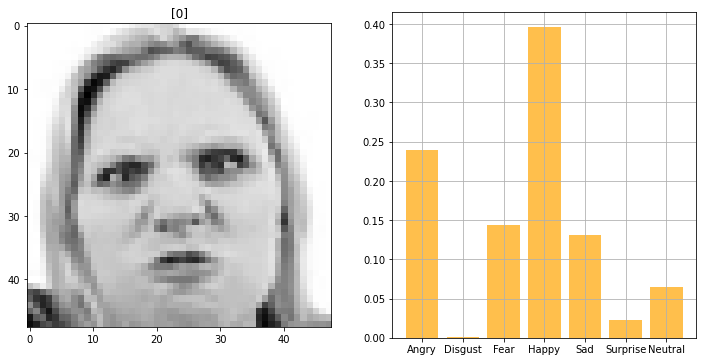

ValueError: ignored

In [ ]:
print_facials(0, 10, 0)

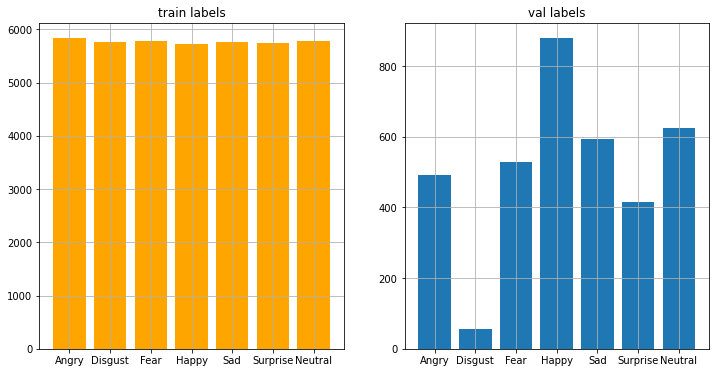

In [ ]:
def plot_compare_distributions(array1, array2, title1='', title2=''):
    df_array1 = pd.DataFrame()
    df_array2 = pd.DataFrame()
    df_array1['emotion'] = array1.argmax(axis=1)
    df_array2['emotion'] = array2.argmax(axis=1)
    
    fig, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=False)
    x = emotions.values()
    
    y = df_array1['emotion'].value_counts()
    keys_missed = list(set(emotions.keys()).difference(set(y.keys())))
    for key_missed in keys_missed:
        y[key_missed] = 0
    axs[0].bar(x, y.sort_index(), color='orange')
    axs[0].set_title(title1)
    axs[0].grid()
    
    y = df_array2['emotion'].value_counts()
    keys_missed = list(set(emotions.keys()).difference(set(y.keys())))
    for key_missed in keys_missed:
        y[key_missed] = 0
    axs[1].bar(x, y.sort_index())
    axs[1].set_title(title2)
    axs[1].grid()
    
    plt.show()
    
plot_compare_distributions(train_labels, val_labels, title1='train labels', title2='val labels')